# Основные модели прогнозирования ВР <a class="tocSkip">

In [ ]:
from itertools import product

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import statsmodels.api as sm
from scipy import stats
from sktime.utils.plotting import plot_correlations
from statsmodels.graphics import tsaplots
from tqdm import tqdm

In [ ]:
import warnings

warnings.simplefilter("ignore")
warnings.filterwarnings("ignore")

In [ ]:
params = {'lines.linewidth': 1.5,
          'lines.solid_capstyle': 'butt',
          'axes.labelsize': 'medium',
          'axes.axisbelow': True,
          'axes.grid': True,
          'axes.linewidth': 1.5,
          'axes.titlesize': 'medium',
          'grid.linestyle': '-',
          'grid.linewidth': 0.5,
          'xtick.major.size': 0,
          'xtick.minor.size': 0,
          'ytick.major.size': 0,
          'ytick.minor.size': 0,
          'figure.subplot.left': 0.08,
          'figure.subplot.right': 0.95,
          'figure.subplot.bottom': 0.07,
          'figure.figsize': (8, 4),
          'figure.autolayout': True,
          'figure.dpi': 300,
          'font.size': 14.0 }
plt.rcParams.update(params)

In [6]:
pd.options.display.max_rows = 999
%cd ..

/home/den/dev/git/time-series-analysis


In [ ]:
np.random.seed(555)

In [ ]:
from scipy.stats import shapiro, ttest_1samp
from sktime.forecasting.arima import ARIMA, AutoARIMA
from sktime.forecasting.model_evaluation import evaluate
from sktime.split import ExpandingWindowSplitter, SlidingWindowSplitter
from statsmodels.graphics.gofplots import qqplot
from statsmodels.stats.diagnostic import acorr_ljungbox, het_breuschpagan
from statsmodels.tsa.stattools import adfuller, kpss

In [ ]:
def unsqueeze_array(arr):
    return np.squeeze([i.squeeze() for i in arr])

In [ ]:
from sklearn.metrics import r2_score
from sktime.performance_metrics.forecasting import (
    MeanAbsoluteError,
    MeanAbsolutePercentageError,
)


def metrics_report(y_true,
                   y_pred
                  ):
    
    """
    Функция оценки качества прогноза. Оценивает персентили распределения ошибки 
    (медиану, среднее, 3й квартиль и 95-персентиль) 
    по абсолютной и относительной процентной ошибки для прогноза с помощью модели (y_pred) и
    для базового прогноза, равному среднему значению вр.
    
    """
    
    mape_func = MeanAbsolutePercentageError()
    mae_func = MeanAbsoluteError()
    
    y_true_mean = y_true.mean()*np.ones(shape=(len(y_true),))
    
    
    mapes = mape_func.evaluate_by_index(y_true,y_pred)*100
    maes = mae_func.evaluate_by_index(y_true,y_pred)
    
    
    mapes_zero = mape_func.evaluate_by_index(y_true,y_true_mean)*100
    maes_zero = mae_func.evaluate_by_index(y_true,y_true_mean)
    
    def quan_75(y,quan=0.75):
        return y.quantile(quan)

    def quan_95(y,quan=0.95):
        return y.quantile(quan)
    
    stats_list = ['mean','median',quan_75,quan_95,'std']
    
    res = pd.DataFrame([maes.agg(stats_list),
                        maes_zero.agg(stats_list),
                        mapes.agg(stats_list),
                        mapes_zero.agg(stats_list)],
                       index=['maes','maes_zero','mapes','mapes_zero'])
    
    res.loc["r2",:] = r2_score(y_true, y_pred)
    
    return res

In [ ]:
from statsmodels.tsa.stattools import adfuller, kpss


def test_trend(row):
    """Case 1: Both tests conclude that the series is not stationary - The series is not stationary
        Case 2: Both tests conclude that the series is stationary - The series is stationary
        Case 3: KPSS indicates stationarity and ADF indicates non-stationarity - The series is trend stationary. Trend needs to be removed to make series strict stationary. The detrended series is checked for stationarity.
        Case 4: KPSS indicates non-stationarity and ADF indicates stationarity - The series is difference stationary. Differencing is to be used to make series stationary. The differenced series is checked for stationarity.
        """
    kpsstest = kpss(row, regression="c", nlags="auto")
    dftest = adfuller(row, autolag="AIC")
    nonstationary_kpss =  kpsstest[1]<0.05
    nonstationary_df = dftest[1]>0.05
    return nonstationary_kpss | nonstationary_df,  kpsstest[1], dftest[1]

In [ ]:
import warnings

from statsmodels.tsa.statespace.sarimax import SARIMAX

warnings.filterwarnings('ignore')

def calc_optimum_sarima(ts,
                        max_p,
                        max_P,
                        max_q,
                        max_Q,
                        d,
                        D,
                        seasonal_period=12,
                        X=None): 
    """
    Подбор оптимальных гиперпараметров модели ARIMA с помощью критерия Акаике.
    Идет перебор всех вариантов (p,P,q,Q) в пределах (0,max_p)*(0,max_P)*(0,max_q)*(0,max_Q)
    
    """
    
    best_bic = float("inf")
    
    ps = range(0, max_p+1)
    qs = range(0, max_q+1)
    Ps = range(0, max_P+1)
    Qs = range(0, max_Q+1)
    parameters = product(ps, qs, Ps, Qs)
    parameters_list = list(parameters)
    
    print(len(parameters_list))
    
    results = []
    for param in tqdm(parameters_list):
        #try except нужен, потому что на некоторых наборах параметров модель не обучается
        try:
            model=sm.tsa.SARIMAX(ts,
                                 exog=X,
                          order=(param[0], d, param[1]), 
                          seasonal_order=(param[2], D, param[3], seasonal_period)).fit(disp=-1)
        #выводим параметры, на которых модель не обучается и переходим к следующему набору
        except ValueError:
            print('wrong parameters:', param)
            continue
        aic = model.aic
        bic = model.bic
        #сохраняем лучшую модель, aic, параметры
        if bic < best_bic:
            best_model = model
            best_bic = aic
            best_param = param
        results.append([param, aic, bic]) 
    
    return results, best_model

In [ ]:
from sktime.transformations.series.boxcox import BoxCoxTransformer


def BC_inverse(y, lam, sig):
    """Back transform Box-Cox with Bias correction.
    See https://robjhyndman.com/hyndsight/backtransforming
    """
    if lam == 0:
        return np.exp(y) * (1 + 0.5 * sig**2)
    else:
        res = np.power(lam*y + 1., 1/lam)
        res *= (1 + 0.5 * sig**2 * (1 - lam) / (lam*y + 1.)**2)
        return res

# Разбор основных моделей вр

## Unobserved components

Про все семейство моделей Ненаблюдаемых компонент можно почитать по ссылке ниже:
    
https://www.statsmodels.org/dev/generated/statsmodels.tsa.statespace.structural.UnobservedComponents.html

Общая формула:
$y_t = \mu_t + \gamma_t + c_t + \varepsilon_t$,

где $\mu_t$ - тренд, $\gamma_t$ - сезонность, $c_t$ - циклическая компонента, $\varepsilon_t$ - ошибка.

In [ ]:
from statsmodels.tsa.api import ExponentialSmoothing as expsmooth
from statsmodels.tsa.api import UnobservedComponents
from statsmodels.tsa.statespace.api import ExponentialSmoothing as expsmoothkalman

Будем рассматривать следующие модели тренда:
* fixed slope
\begin{split}y_t &= \mu_t \\
\mu_t &= \mu_{t-1} + \beta\end{split}
* Deterministic trend
\begin{align*}
y_t &= \mu_t + \varepsilon_t \\
\mu_t &= \mu_{t-1} + \beta
\end{align*}
* Local linear deterministic trend
\begin{split}y_t &= \mu_t + \varepsilon_t \\
\mu_t &= \mu_{t-1} + \beta + \eta_t\end{split}
* Local linear trend
\begin{split}y_t &= \mu_t + \varepsilon_t \\
\mu_t &= \mu_{t-1} + \beta_{t-1} + \eta_t \\
\beta_t &= \beta_{t-1} + \zeta_t\end{split}

сезонность:

\begin{split}\gamma_t = - \sum_{j=1}^{s-1} \gamma_{t+1-j} + \omega_t \\
\omega_t \sim N(0, \sigma_\omega^2)\end{split}

In [ ]:
# к ним для оценки добавим мультипликативное ЭСС и ЭСС с фильтром Калмана
# инициализируем список с зафиксированными параметрами модели и их названием
# второй параметр (True,False) отвечает за то, принтится ли лог обучения при вызове метода fit (чтобы его отключить)
models = [("ets_kalm",
           True,
           lambda x: expsmoothkalman(x, 
                                     seasonal  = 12,
                                     trend = True,
                                     initialization_method='heuristic',)),
          ("ets",
           False,
           lambda x: expsmooth(x, 
                               seasonal_periods = 12,
                               trend = "mul",
                               seasonal="mul",
                               initialization_method='heuristic')),
          ("unobs_fixed_slope",
           True,
           lambda x:UnobservedComponents(x, 
                                         seasonal  = 12,
                                         level  = "fixed slope",
                                         irregular=True, 
                                         initialization_method='heuristic',)),
          ("unobs_deterministic_trend",
           True,
           lambda x:UnobservedComponents(x, 
                                         seasonal  = 12,
                                         level  = "deterministic trend",
                                         irregular=True, 
                                         initialization_method='heuristic',)),
          ("unobs_local_linear_deterministic_trend",
           True,
           lambda x: UnobservedComponents(x, 
                                          seasonal  = 12,  
                                          level  = "local linear deterministic trend",
                                          irregular=True, 
                                          initialization_method='heuristic',)),
          ("unobs_local_linear_trend",
           True,
           lambda x:UnobservedComponents(x, 
                                         seasonal  = 12,
                                         level  = "local linear trend",
                                         irregular=True, 
                                         initialization_method='heuristic',))]

In [ ]:
airline = pd.read_csv('data/international-airline-passengers.csv', sep=';')
airline['Month'] = pd.to_datetime(airline['Month']+'-01')
airline.set_index('Month', inplace=True)
# отложим последние 24 наблюдения в тест
airline_test = airline.iloc[-24:]
airline = airline.iloc[:-24]

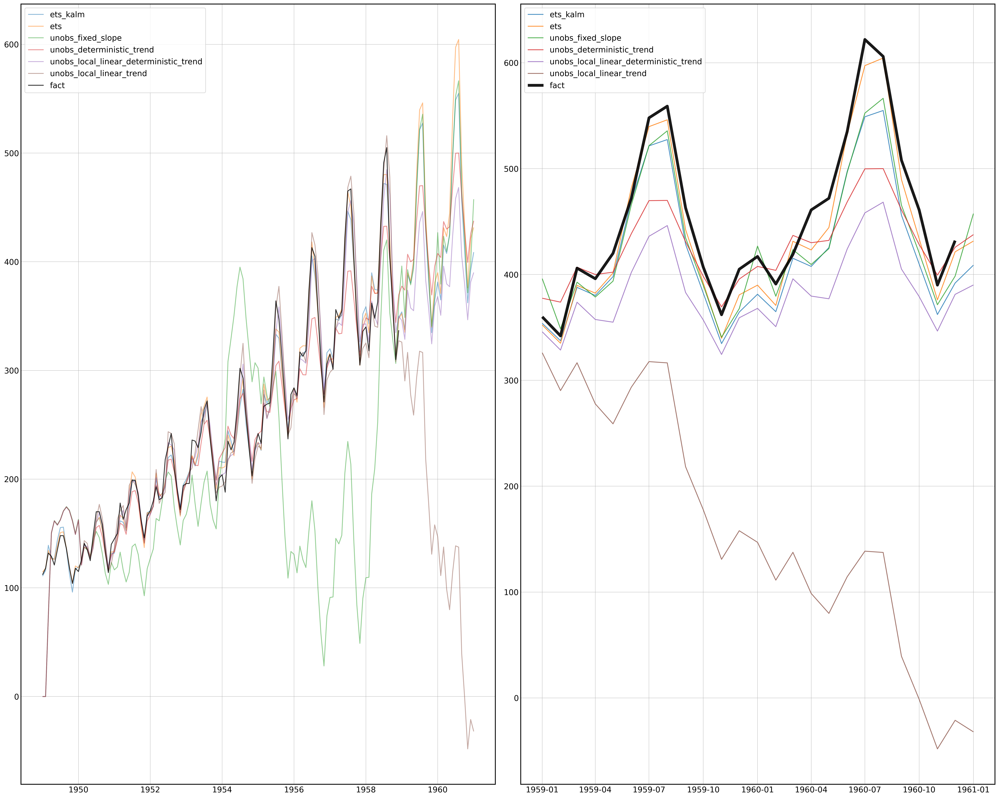

In [ ]:
# посмотрим как выглядит решение с помощью ЭСС для различных гиперпараметров:
# тренд - аддитивный/мультипликативный, затухающий/не затухающий
# отобразим все наблюдения на трэйне и на тест
fig,ax = plt.subplots(1,2,figsize=(25,20))
for label,disp,model in models:
    es1 = model(airline['Passengers'].resample("MS").sum())
    if disp:
        es1 = es1.fit(disp=0);
    else:
         es1 = es1.fit();
    ax[0].plot(es1.predict(start=0,end= len(airline)+24),alpha = 0.5,label=label)
    ax[1].plot(es1.predict(start=len(airline),end= len(airline)+24),alpha = 0.8,label=label)

ax[0].plot(airline['Passengers'],alpha = 0.8,c='black',label='fact')
ax[1].plot(airline_test['Passengers'],alpha = 0.9,c='black',label='fact',linewidth=5)
ax[0].legend()
ax[1].legend();

Можно отметить несколько вещей. Во-первых, инициализация параметров затрагивает первые 12 точек - в них модели хуже описывают обучающую выборку. Во-вторых, за счёт отсутствия мультипликативности модели ненаблюдаемых компонент (модели пространства состояний) перформят хуже, чем мультипликативное ЭСС, причем, чем больше мы увеличиваем неопределенность, тем больше у нас ошибка, т.к. у нас можно сказать "без сомнений" ярко выраженный положительный тренд


In [ ]:
new_data = airline['Passengers'].resample("MS").sum()

#level  = "fixed slope"
#level  = "deterministic trend"
#level  = "local linear deterministic trend"
level  = "local linear trend"

es1 = UnobservedComponents(new_data, 
                           level  = level,
                           irregular=False,
                           mle_regression=True,
                           autoregressive=0,
                           seasonal=12)
es1 = es1.fit(disp=0)

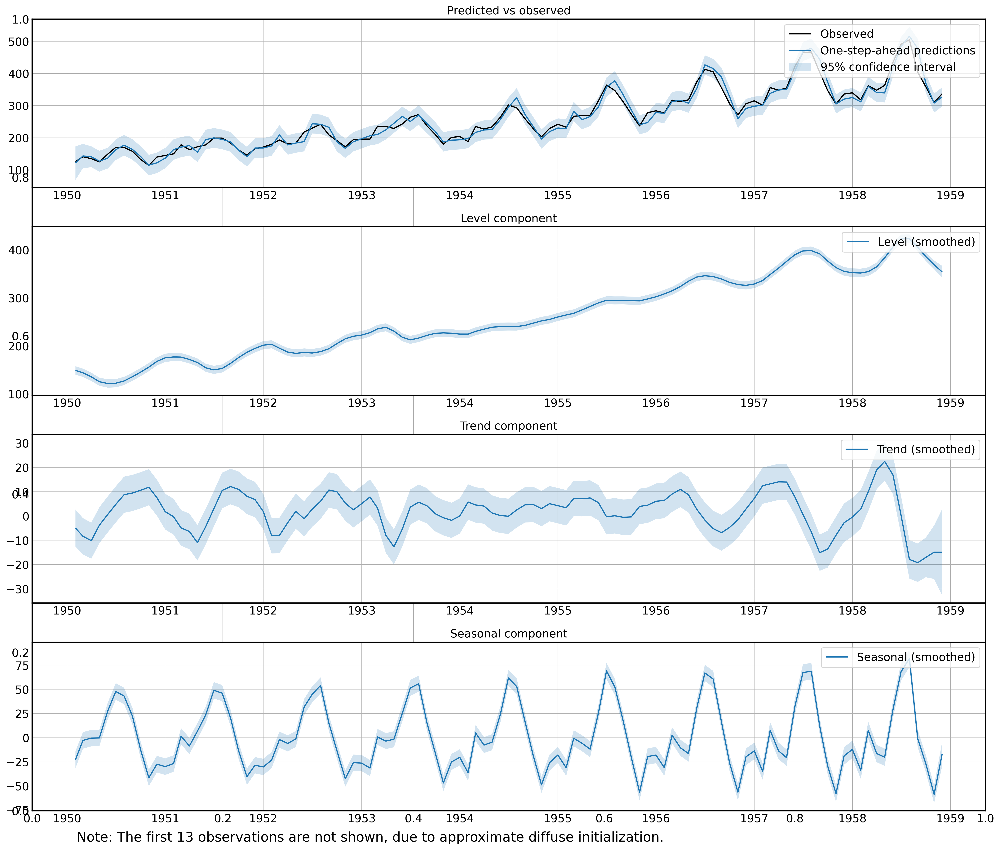

In [ ]:
fig,ax = plt.subplots(1,1,figsize=(18,15))
es1.plot_components(fig=fig);

In [ ]:
es1.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            Unobserved Components Results                            
=====================================================================================
Dep. Variable:                    Passengers   No. Observations:                  120
Model:                    local linear trend   Log Likelihood                -445.178
                   + stochastic seasonal(12)   AIC                            898.356
Date:                       Thu, 07 Aug 2025   BIC                            909.048
Time:                               19:06:55   HQIC                           902.690
Sample:                           01-01-1949                                         
                                - 12-01-1958                                         
Covariance Type:                         opg                                         
====================================================================================
                       coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------
sigma2.irregular  4.955e-09     21.596   2.29e-10      1.000     -42.328      42.328
sigma2.level      9.044e-09     52.937   1.71e-10      1.000    -103.754     103.754
sigma2.trend        50.7414     20.595      2.464      0.014      10.375      91.108
sigma2.seasonal     16.6074      4.650      3.572      0.000       7.494      25.721
===================================================================================
Ljung-Box (L1) (Q):                   5.72   Jarque-Bera (JB):               112.03
Prob(Q):                              0.02   Prob(JB):                         0.00
Heteroskedasticity (H):               3.78   Skew:                            -1.31
Prob(H) (two-sided):                  0.00   Kurtosis:                         7.27
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [ ]:
# те же модели, но без ЭСС
models = [("unobs_fixed_slope",
           True,
           lambda x:UnobservedComponents(x, 
                                         seasonal  = 12,
                                         stochastic_seasonal=False,
                                         level  = "fixed slope",
                                         irregular=True,)),
          ("unobs_deterministic_trend",
           True,
           lambda x:UnobservedComponents(x, 
                                         seasonal  = 12,
                                         stochastic_seasonal=False,
                                         level  = "deterministic trend",
                                         irregular=True, 
                                         initialization_method='estimated',)),
          ("unobs_local_linear_deterministic_trend",
           True,
           lambda x: UnobservedComponents(x, 
                                          seasonal  = 12,  
                                          level  = "local linear deterministic trend",
                                          stochastic_seasonal=False,
                                          irregular=True, 
                                          initialization_method='estimated',)),
          ("unobs_local_linear_trend",
           True,
           lambda x:UnobservedComponents(x, 
                                         seasonal  = 12,
                                         level  = "local linear trend",
                                         irregular=True, 
                                         stochastic_seasonal=False,
                                         initialization_method='estimated',))]

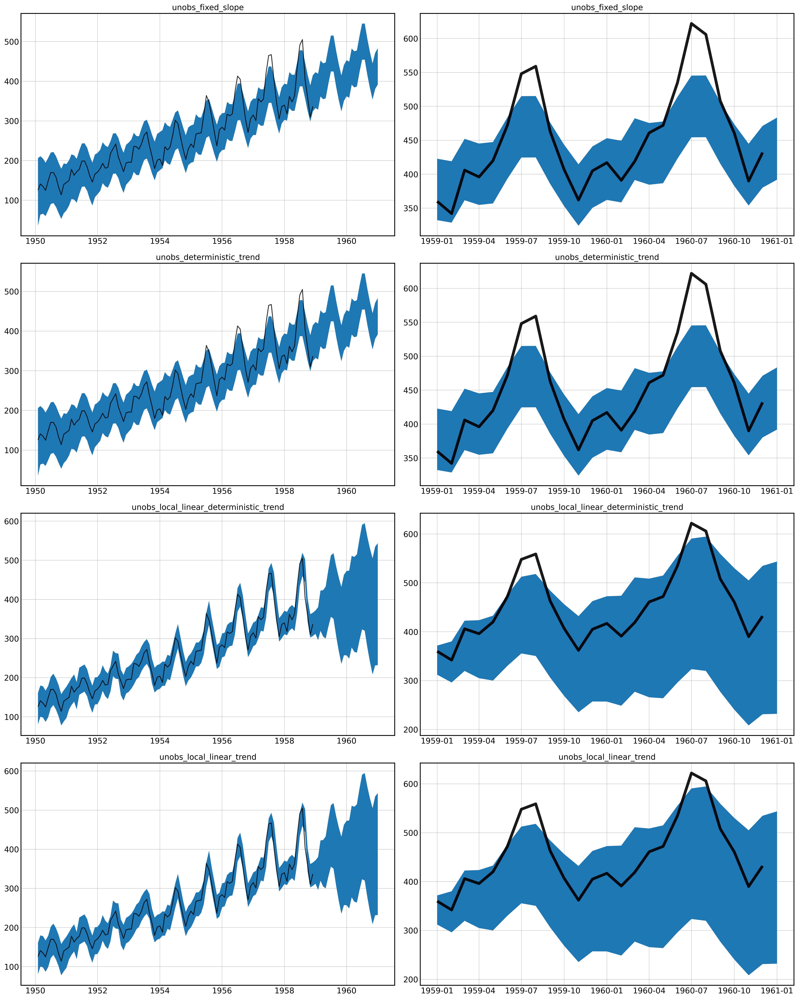

In [ ]:
# теперь посмотрим на прогнозы и доверительные интервалы 
fig,ax = plt.subplots(len(models),2,figsize=(20,25))

for i,md in enumerate(models):
    label,disp,model = md
    es1 = model(airline['Passengers'].resample("MS").sum())
    if disp:
        es1 = es1.fit(disp=0);
    else:
         es1 = es1.fit();
    
    preds = es1.get_prediction(start=0,end= len(airline)+24)
    preds_sum = preds.summary_frame()
    
    
    ax[i][0].plot(preds_sum.iloc[13:,]['mean'],alpha = 0.5,label=label)
    ax[i][0].fill_between(preds_sum.iloc[13:,].index, 
                          preds_sum.iloc[13:,].mean_ci_lower, 
                          preds_sum.iloc[13:,].mean_ci_upper)
    
    
    
    ax[i][1].plot(preds_sum.iloc[len(airline):,]['mean'],alpha = 0.8,label=label)
    ax[i][1].fill_between(preds_sum.iloc[len(airline):,].index, 
                       preds_sum.iloc[len(airline):,].mean_ci_lower, 
                       preds_sum.iloc[len(airline):,].mean_ci_upper)

    ax[i][0].plot(airline.iloc[13:,]['Passengers'],alpha = 0.8,c='black',label='fact')
    ax[i][1].plot(airline_test['Passengers'],alpha = 0.9,c='black',label='fact',linewidth=5)
    
    ax[i][0].set_title(label)
    ax[i][1].set_title(label)

величина доверительного интервала зависит от двух вещей: сколько у нас случайных блужданий в компонентах и от ошибки на трэйне. Нужно соблюдать баланс: чтобы д.и., с одной стороны, не был слишком большим, при этом чтобы 95% наблюдений попадало в него

Модели пространства состояний, в первую очередь, применяются для байесовского а/б тестирования 

## Prophet

$y(t) = g(t) + s(t) + h(t) + \epsilon_{t}$, где

$g(t)$ - Trend, models non-periodic changes.

$s(t)$ - Seasonality, represents periodic changes.

$h(t)$ - Holidays component, contributes information about holidays and events.

In [ ]:
from prophet import Prophet

В качестве данных будем использовать данные о продажах в магазине испанского ритейлера. Попробуем научиться предсказывать продажи данного ритейлера по стране. Помимо данных о продажах, у нас также есть данные о праздниках в Испании за эти же даты

In [ ]:
df_transactions = pd.read_csv('data/transactions.csv')
df_holidays_events = pd.read_csv('data/holidays_events.csv')

In [ ]:
df_transactions.head()

,date,store_nbr,transactions
0,2013-01-01,25,770
1,2013-01-02,1,2111
2,2013-01-02,2,2358
3,2013-01-02,3,3487
4,2013-01-02,4,1922


In [ ]:
# агрегируем данные по дате
df_transactions['date'] = pd.to_datetime(df_transactions['date'])
transactions = df_transactions.groupby('date')['transactions'].sum()

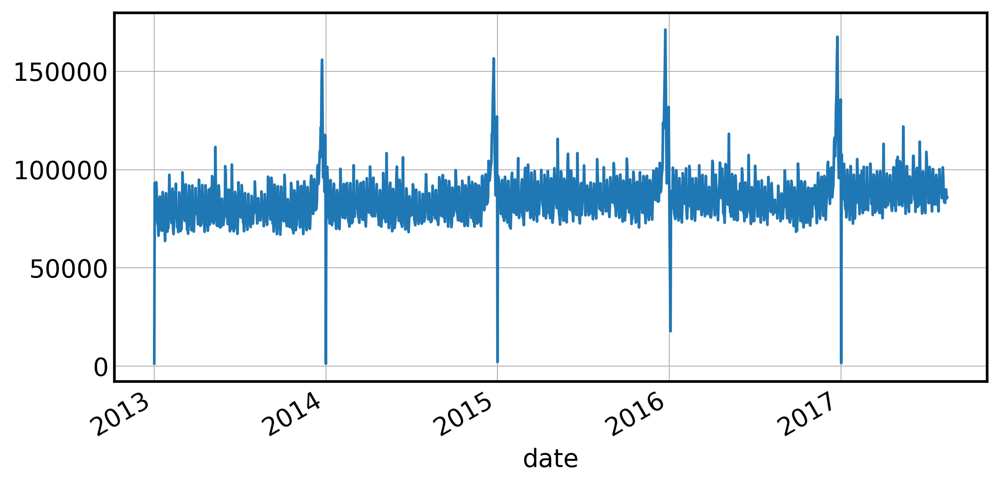

In [ ]:
transactions.plot();

In [ ]:
# для профета важно, чтобы df содержал как минимум 2 колонки: ds - время и y - таргет
transactions = pd.DataFrame(transactions).reset_index()
transactions.columns = ['ds', 'y']
transactions

,ds,y
0,2013-01-01,770
1,2013-01-02,93215
2,2013-01-03,78504
3,2013-01-04,78494
4,2013-01-05,93573
...,...,...
1677,2017-08-11,89551
1678,2017-08-12,89927
1679,2017-08-13,85993
1680,2017-08-14,85448


In [ ]:
# fit_predict для профета реализовывается в несколько строчек
# по умолчанию профет оценивает частоту данных и моделирует соответствующие сезонности
# в этом примере он моделирует недельную и годовую сезонности
m = Prophet()
m.fit(transactions)
future = m.make_future_dataframe(periods=365) # утила для создания датафрэйма с будущими датами
forecast = m.predict(future)
forecast.tail(14)

19:07:06 - cmdstanpy - INFO - Chain [1] start processing
19:07:07 - cmdstanpy - INFO - Chain [1] done processing


,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
2033,2018-08-02,97217.810508,77494.266245,97899.414288,96191.006807,98204.317735,-9084.011159,-9084.011159,-9084.011159,-7236.198574,-7236.198574,-7236.198574,-1847.812585,-1847.812585,-1847.812585,0.0,0.0,0.0,88133.799350
2034,2018-08-03,97234.849808,83755.474123,103361.683865,96205.078402,98225.853857,-3674.993625,-3674.993625,-3674.993625,-1661.049428,-1661.049428,-1661.049428,-2013.944197,-2013.944197,-2013.944197,0.0,0.0,0.0,93559.856184
2035,2018-08-04,97251.889108,97353.312335,118389.430092,96218.765241,98247.158762,10766.900465,10766.900465,10766.900465,12952.759606,12952.759606,12952.759606,-2185.859141,-2185.859141,-2185.859141,0.0,0.0,0.0,108018.789573
2036,2018-08-05,97268.928409,92209.217600,112871.918617,96228.681719,98268.408424,5196.459020,5196.459020,5196.459020,7553.435051,7553.435051,7553.435051,-2356.976031,-2356.976031,-2356.976031,0.0,0.0,0.0,102465.387429
2037,2018-08-06,97285.967709,81439.682935,102205.174086,96238.598196,98289.658086,-5548.002978,-5548.002978,-5548.002978,-3027.366792,-3027.366792,-3027.366792,-2520.636186,-2520.636186,-2520.636186,0.0,0.0,0.0,91737.964731
2038,2018-08-07,97303.007009,79877.556201,99974.986653,96248.514674,98311.227229,-7510.968317,-7510.968317,-7510.968317,-4840.650775,-4840.650775,-4840.650775,-2670.317542,-2670.317542,-2670.317542,0.0,0.0,0.0,89792.038692
2039,2018-08-08,97320.046309,80607.971719,99950.555235,96258.431151,98333.016308,-6540.775575,-6540.775575,-6540.775575,-3740.929088,-3740.929088,-3740.929088,-2799.846487,-2799.846487,-2799.846487,0.0,0.0,0.0,90779.270734
2040,2018-08-09,97337.085609,76719.654930,97133.821104,96270.176381,98354.805386,-10139.799548,-10139.799548,-10139.799548,-7236.198574,-7236.198574,-7236.198574,-2903.600975,-2903.600975,-2903.600975,0.0,0.0,0.0,87197.286060
2041,2018-08-10,97354.124909,83019.255162,103194.409592,96283.316478,98376.631652,-4637.747955,-4637.747955,-4637.747955,-1661.049428,-1661.049428,-1661.049428,-2976.698527,-2976.698527,-2976.698527,0.0,0.0,0.0,92716.376954
2042,2018-08-11,97371.164209,97462.020689,117577.503878,96296.456574,98400.155136,9937.596521,9937.596521,9937.596521,12952.759606,12952.759606,12952.759606,-3015.163085,-3015.163085,-3015.163085,0.0,0.0,0.0,107308.760729


RMSE: 7902.699744


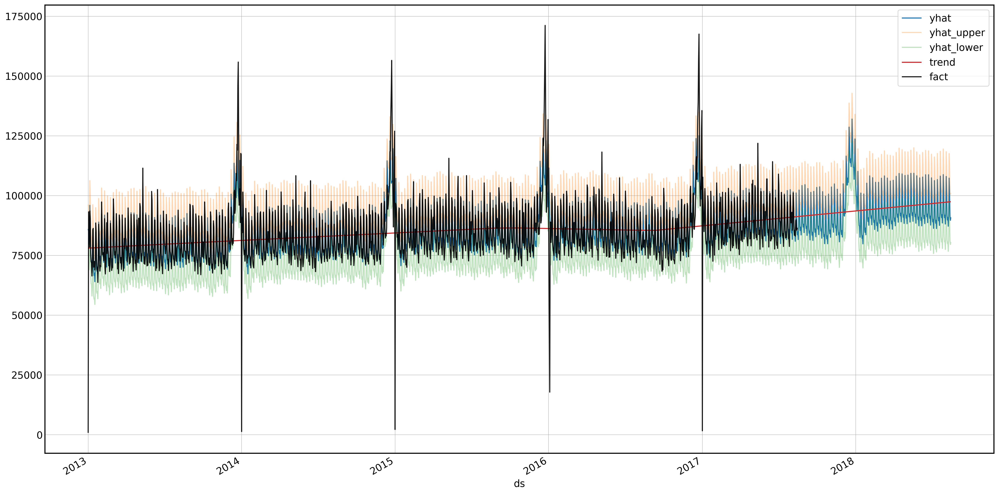

In [ ]:
# график факта и прогноза на год вперед с доверительным интервалом и трендом
print('RMSE: %f' % np.sqrt(np.mean((forecast.loc[:1682, 'yhat']-transactions['y'])**2)) )
forecast.set_index("ds",inplace=True)
plt.figure(figsize=(20, 10))
forecast.yhat.plot()
forecast.yhat_upper.plot(alpha=0.3)
forecast.yhat_lower.plot(alpha=0.3)
forecast.trend.plot()
plt.plot(transactions.ds.values, transactions.y.values, c='black', alpha=0.9);
plt.legend(["yhat", "yhat_upper", "yhat_lower", "trend", "fact"]);

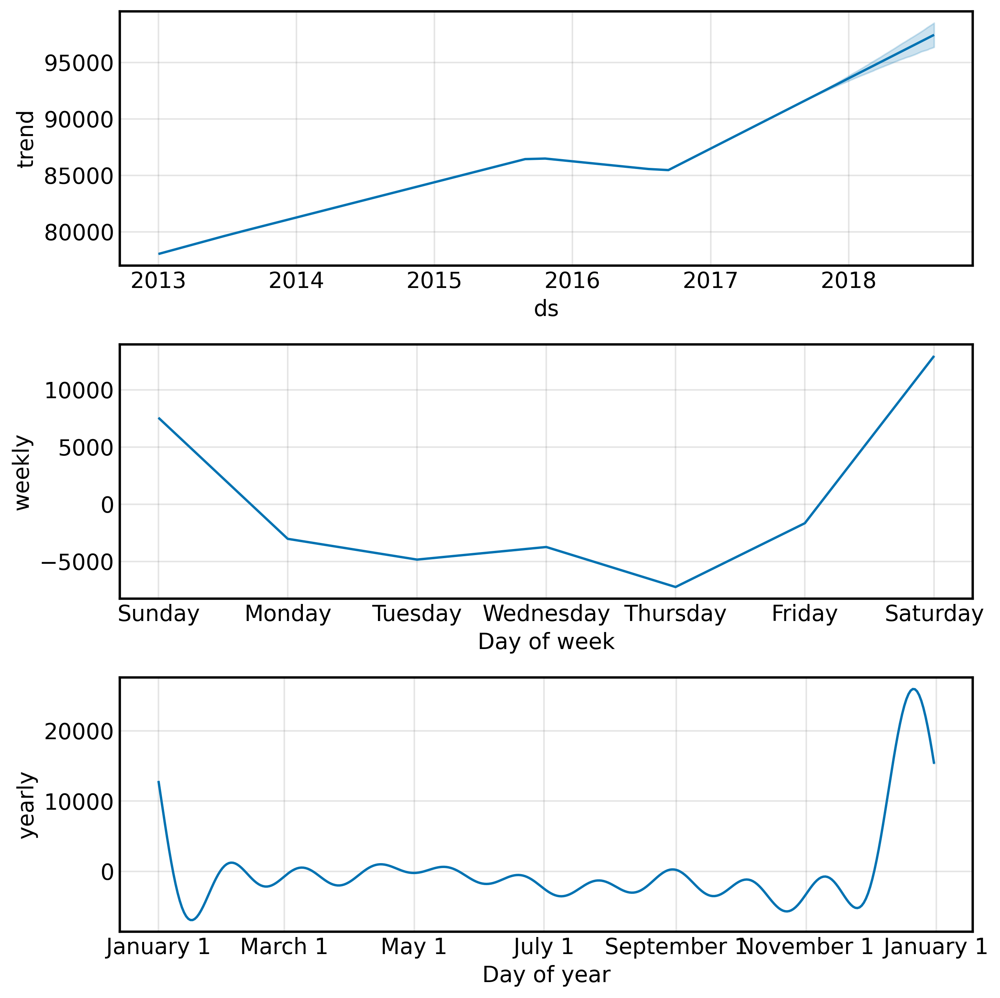

In [ ]:
# график основных компонент 
# сезонности моделируются рядами фурье
m.plot_components(forecast.reset_index());

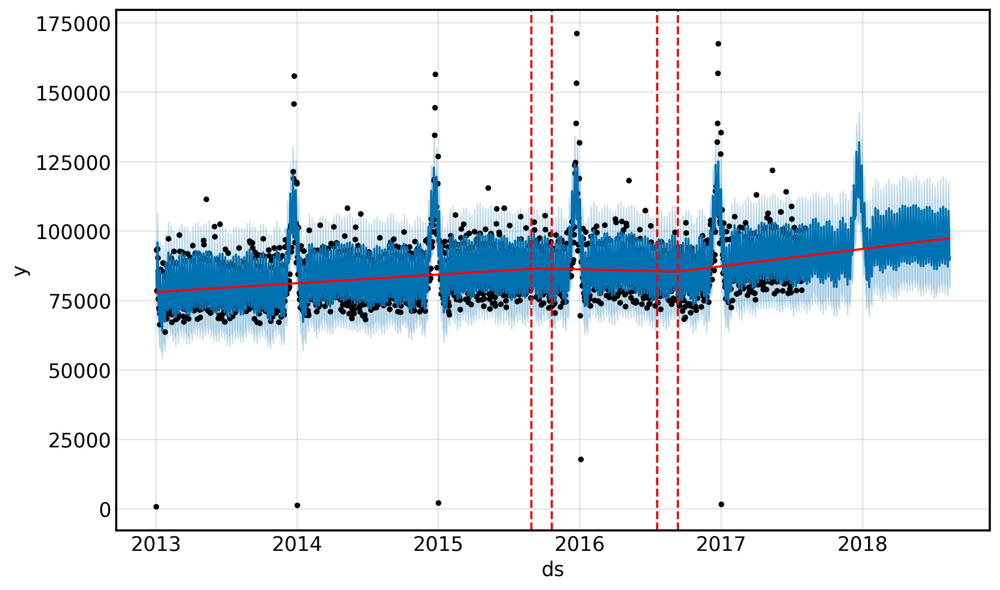

In [ ]:
# в качестве тренда профет использует кусочно-линейную функцию 
# на графики показаны выбранные точки излома
from prophet.plot import add_changepoints_to_plot

fig = m.plot(forecast.reset_index())
a = add_changepoints_to_plot(fig.gca(), m, forecast.reset_index())

давайте теперь посмотрим, что можно сделать, чтобы улучшить этот прогноз

для начала давайте добавим информацию о праздниках

In [ ]:
df_holidays_events.head()

,date,type,locale,locale_name,description,transferred
0,2012-03-02,Holiday,Local,Manta,Fundacion de Manta,False
1,2012-04-01,Holiday,Regional,Cotopaxi,Provincializacion de Cotopaxi,False
2,2012-04-12,Holiday,Local,Cuenca,Fundacion de Cuenca,False
3,2012-04-14,Holiday,Local,Libertad,Cantonizacion de Libertad,False
4,2012-04-21,Holiday,Local,Riobamba,Cantonizacion de Riobamba,False


In [ ]:
# для праздников есть специальный формат датафрэйма, куда входят ds (время),
# holiday - название праздника, lower_window и upper_window - дней до и после
# праздника, когда действует этот эффект
holidays = df_holidays_events[df_holidays_events['transferred'] == False][['description', 'date']]
holidays.columns = ['holiday', 'ds']
# здесь с окнами работать не будем
holidays['lower_window'] = 0
holidays['upper_window'] = 0
holidays.head()

,holiday,ds,lower_window,upper_window
0,Fundacion de Manta,2012-03-02,0,0
1,Provincializacion de Cotopaxi,2012-04-01,0,0
2,Fundacion de Cuenca,2012-04-12,0,0
3,Cantonizacion de Libertad,2012-04-14,0,0
4,Cantonizacion de Riobamba,2012-04-21,0,0


In [ ]:
holidays[holidays.holiday.str.contains("Primer dia del ano")]

,holiday,ds,lower_window,upper_window
39,Puente Primer dia del ano,2012-12-31,0,0
40,Primer dia del ano-1,2012-12-31,0,0
41,Primer dia del ano,2013-01-01,0,0
91,Primer dia del ano-1,2013-12-31,0,0
92,Primer dia del ano,2014-01-01,0,0
158,Primer dia del ano-1,2014-12-31,0,0
159,Primer dia del ano,2015-01-01,0,0
160,Puente Primer dia del ano,2015-01-02,0,0
161,Recupero Puente Primer dia del ano,2015-01-10,0,0
210,Primer dia del ano-1,2015-12-31,0,0


In [ ]:
#добавили еще пару изменений: 
#1. увеличили влияние сезонности (seasonality_prior_scale) - может иметь бОльшую дисперсию
#2. увеличили кол-во точек изменения тренда (changepoint_prior_scale)
#3. добавили помесячную сезонность и праздники
m = Prophet(changepoint_prior_scale=2.5, holidays=holidays,seasonality_prior_scale=20.0)
m.add_seasonality(name='monthly', period=30.5, fourier_order=5)
m.fit(transactions)
future = m.make_future_dataframe(periods=365)
forecast = m.predict(future)

19:07:16 - cmdstanpy - INFO - Chain [1] start processing
19:07:17 - cmdstanpy - INFO - Chain [1] done processing


RMSE: 4929.455398


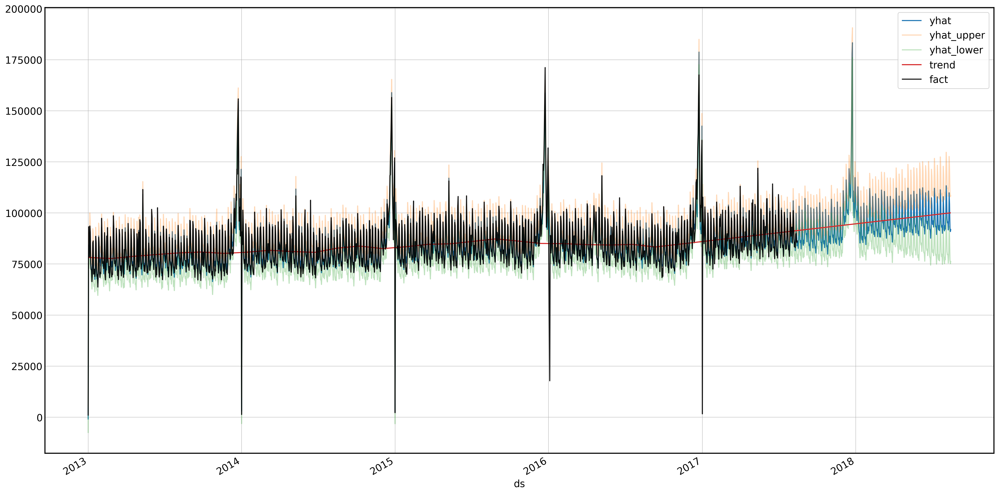

In [ ]:
# погрешность уменьшилась в полтора раза!
print('RMSE: %f' % np.sqrt(np.mean((forecast.loc[:1682, 'yhat']-transactions['y'])**2)) )
forecast.set_index("ds",inplace=True)
plt.figure(figsize=(20,10))
forecast.yhat.plot()
forecast.yhat_upper.plot(alpha=0.3)
forecast.yhat_lower.plot(alpha=0.3)
forecast.trend.plot();
plt.plot(transactions.ds.values,transactions.y.values,c='black',alpha=0.9)
plt.legend(["yhat", "yhat_upper", "yhat_lower", "trend", "fact"]);

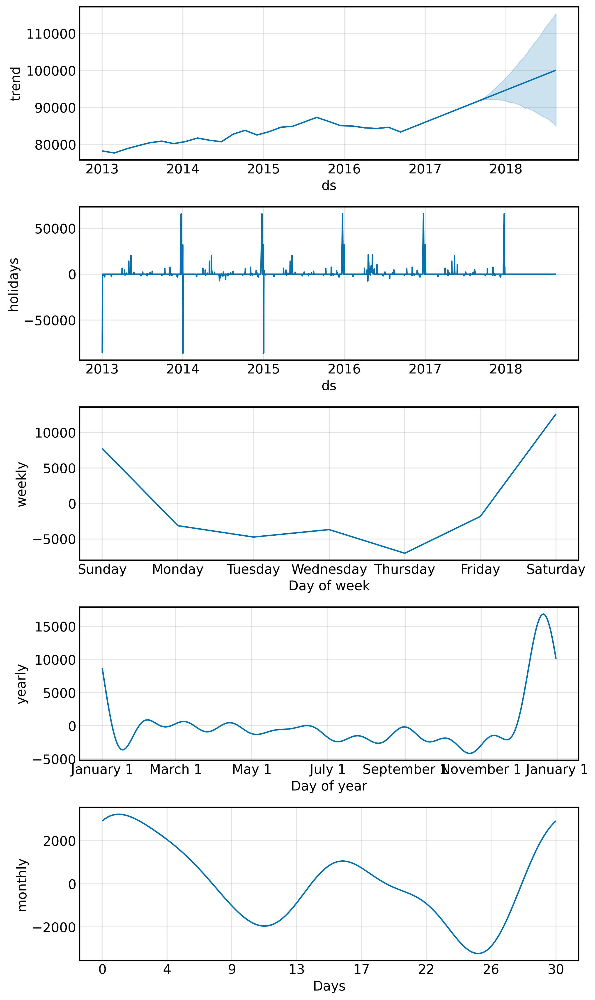

In [ ]:
m.plot_components(forecast.reset_index());

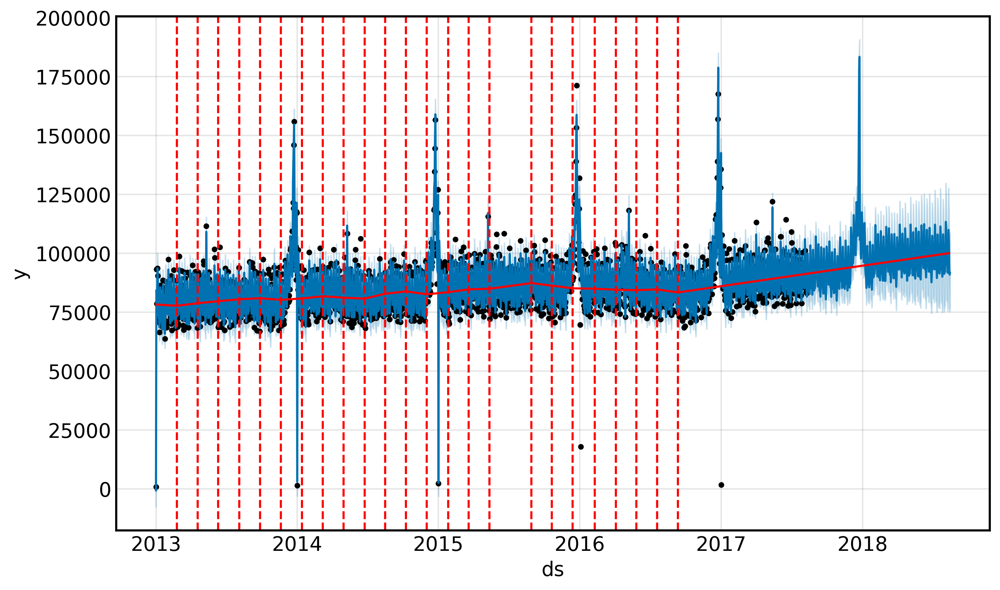

In [ ]:
# сильно увеличилось кол-во точек изменения тренда, он стал более адаптивным
from prophet.plot import add_changepoints_to_plot

fig = m.plot(forecast.reset_index())
a = add_changepoints_to_plot(fig.gca(), m, forecast.reset_index())

Как измерить "силу" тренда или сезонности?

Пусть у нас ряд имеет адитивные тренд и сезонность:
$y_t = T_t + S_{t} + R_t,$

Тогда для тренда:

$F_T = \max\left(0, 1 - \frac{\text{Var}(R_t)}{\text{Var}(T_t+R_t)}\right)$

а для сезонности:

$F_S = \max\left(0, 1 - \frac{\text{Var}(R_t)}{\text{Var}(S_{t}+R_t)}\right)$

In [ ]:
Rt = forecast.iloc[:-365,:].yhat.subtract(transactions.set_index("ds").y.values,axis=0)
Tt = forecast.iloc[:-365,:].trend
Swt = forecast.iloc[:-365,:].weekly
Syt = forecast.iloc[:-365,:].yearly
Smt = forecast.iloc[:-365,:].monthly

In [ ]:
# в целом, все сезонности и тренд отличны от нуля
print(max(0,1-Rt.var()/(Tt+Rt).var()))
print(max(0,1-Rt.var()/(Swt+Rt).var()))
print(max(0,1-Rt.var()/(Syt+Rt).var()))
print(max(0,1-Rt.var()/(Smt+Rt).var()))

0.2826018860631663
0.650888796663508
0.36495435671524346
0.11735255250372645


## TBATS

TBATS = Trigonometric, Box-Cox transformation, ARMA, Trend, Seasonality.

Тоже универсальный фрэймворк, который может давать предсказания из коробки, но, который, к сожалению, довольно долго обучается.

In [ ]:
from sktime.forecasting.tbats import TBATS

In [ ]:
transactions_series = transactions.set_index("ds").resample("D").sum().y

TBATS может быть удобен для первоначальной диагностики ряда

In [ ]:
forecaster = TBATS(  

    use_box_cox=None,

    use_trend=None,

    use_damped_trend=None,

    sp=[7.,365.25, 30.5],

    use_arma_errors=True,)

In [ ]:
forecaster.fit(transactions_series)

In [ ]:
# можно посмотреть все коэффициенты, которые tbats посчитал важными
fitted_model = forecaster._forecaster
print('\n\nMODEL SUMMARY\n\n')
params = fitted_model.params
components = fitted_model.params.components

print('Smoothing parameter', params.alpha)

print('Seasonal periods',
      components.seasonal_periods)  # TBATS may choose non-seasonal model even if you provide seasons
print('Harmonics amount for each season', components.seasonal_harmonics)
print('1st seasonal smoothing parameters', params.gamma_1())  # one value for each season
print('2nd seasonal smoothing parameters', params.gamma_2())  # one value for each season

print('Trend and damping', components.use_trend, components.use_damped_trend)
print('Trend', params.beta)
print('Damping', params.phi)

print('Use Box-Cox', components.use_box_cox)
print('Box-Cox lambda interval that was considered', components.box_cox_bounds)
print('Box-Cox lambda', params.box_cox_lambda)

print('ARMA residuals modelling', components.use_arma_errors)
print('ARMA(p, q)', components.p, components.q)
print('AR parameters', params.ar_coefs)
print('MA parameters', params.ma_coefs)

print('Seed state', params.x0)

# Short model summary
print('\n\nSUMMARY FUNCTION\n\n')
print(fitted_model.summary())



MODEL SUMMARY


Smoothing parameter 0.13018196953342526
Seasonal periods [  7.    30.5  365.25]
Harmonics amount for each season [3 6 1]
1st seasonal smoothing parameters [ 0.00097759 -0.00105756 -0.00460638]
2nd seasonal smoothing parameters [0.00100409 0.00069856 0.00202714]
Trend and damping False False
Trend None
Damping None
Use Box-Cox False
Box-Cox lambda interval that was considered (0, 1)
Box-Cox lambda None
ARMA residuals modelling False
ARMA(p, q) 0 0
AR parameters []
MA parameters []
Seed state [ 7.08587734e+04 -5.28176087e+03  1.20884895e+03 -3.66927126e+02
 -6.11897911e+03  4.91929838e+03 -1.25890802e+03  5.85966718e+02
  1.89969165e+03 -3.49159876e+02 -1.10983752e+03  2.68118580e+02
 -4.94473578e+01  2.16999258e+02 -2.14847533e+02 -7.16505465e+02
  3.22960909e+02  6.96202943e+02  1.36819504e+02  1.59239827e+03
  1.01578578e+03]


SUMMARY FUNCTION


Use Box-Cox: False
Use trend: False
Use damped trend: False
Seasonal periods: [  7.    30.5  365.25]
Seasonal harmonics [3

# Рекап старых моделей

In [ ]:
shipment = pd.read_csv('data/UMTMVS.csv',index_col='DATE',parse_dates=True)
shipment.index.freq = 'MS'
shipment.head()

,UMTMVS
DATE,
1992-01-01,209438.0
1992-02-01,232679.0
1992-03-01,249673.0
1992-04-01,239666.0
1992-05-01,243231.0


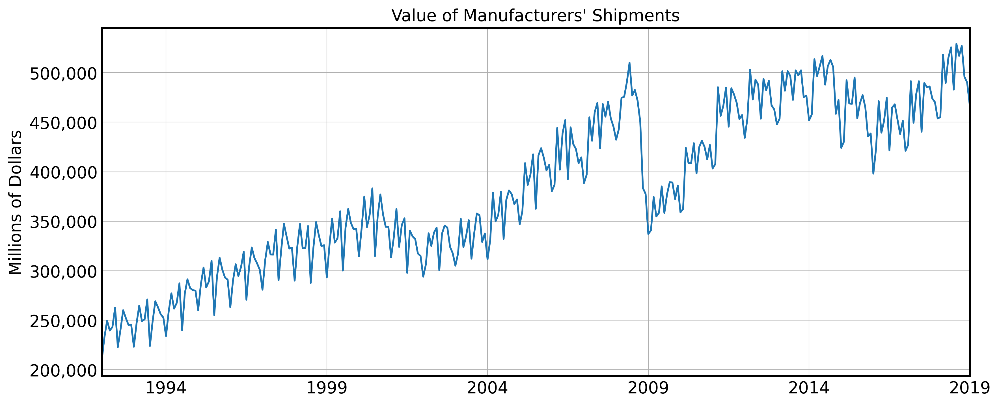

In [ ]:
import matplotlib.ticker as ticker

formatter = ticker.StrMethodFormatter('{x:,.0f}')

title="Value of Manufacturers' Shipments" 
ylabel='Millions of Dollars'
xlabel='' 

ax = shipment['UMTMVS'].plot(figsize=(12,5),title=title)
ax.autoscale(axis='x',tight=True)
ax.set(xlabel=xlabel, ylabel=ylabel)
ax.yaxis.set_major_formatter(formatter);

In [ ]:
airline_add.seasonal.iloc[:12]

DATE
1992-01-01    0.909693
1992-02-01    0.956151
1992-03-01    1.056194
1992-04-01    0.992530
1992-05-01    1.019449
1992-06-01    1.064639
1992-07-01    0.935891
1992-08-01    1.026733
1992-09-01    1.048379
1992-10-01    1.027909
1992-11-01    0.980770
1992-12-01    0.981663
Freq: MS, Name: seasonal, dtype: float64

In [ ]:
shipment[shipment.index>pd.to_datetime("2008-07-01")].head(12)

,UMTMVS
DATE,
2008-08-01,482530.0
2008-09-01,471799.0
2008-10-01,450521.0
2008-11-01,383475.0
2008-12-01,377578.0
2009-01-01,337101.0
2009-02-01,340896.0
2009-03-01,374521.0
2009-04-01,354790.0


In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose

In [ ]:
airline_add = seasonal_decompose(shipment['UMTMVS'],
                                 model='mul',
                                 filt=None,
                                 period=12,
                                 two_sided=True,
                                 extrapolate_trend=1)

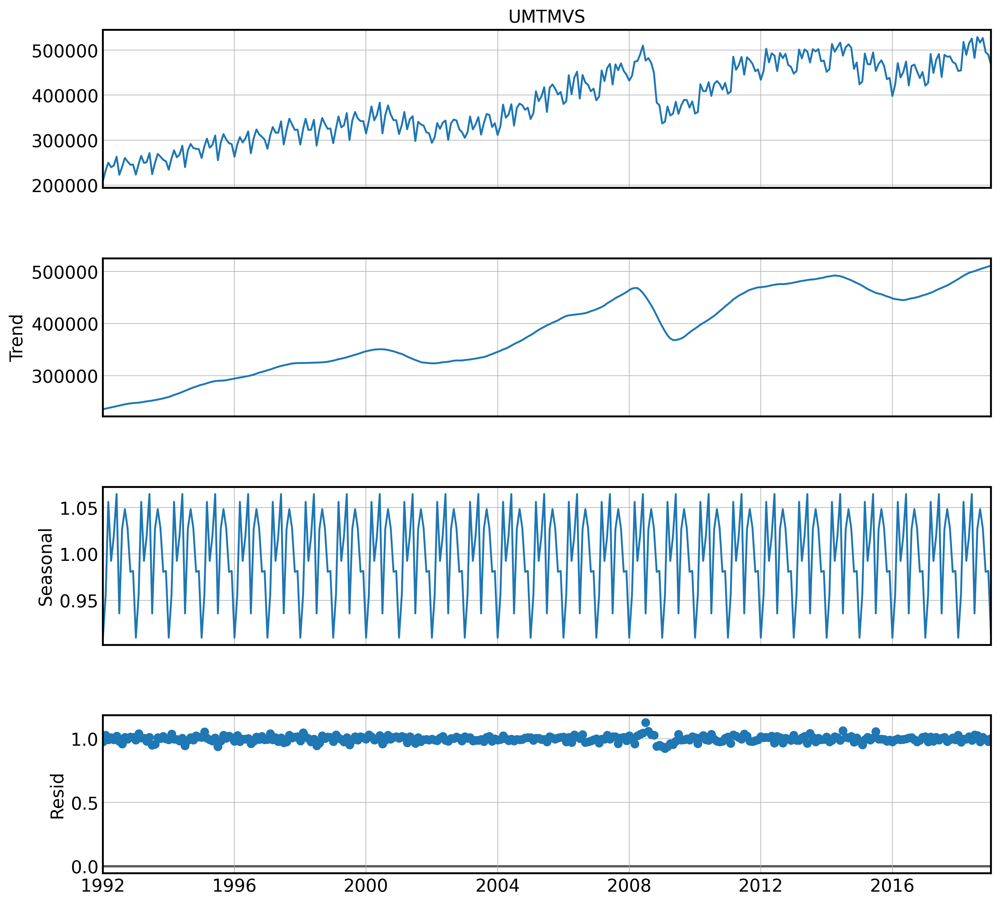

In [ ]:
fig = airline_add.plot();
fig.set_size_inches((12,12))

In [ ]:
airline_add.seasonal.iloc[:12]

DATE
1992-01-01    0.909693
1992-02-01    0.956151
1992-03-01    1.056194
1992-04-01    0.992530
1992-05-01    1.019449
1992-06-01    1.064639
1992-07-01    0.935891
1992-08-01    1.026733
1992-09-01    1.048379
1992-10-01    1.027909
1992-11-01    0.980770
1992-12-01    0.981663
Freq: MS, Name: seasonal, dtype: float64

In [ ]:
shipment['fall_flag'] = (shipment.index>pd.to_datetime("2008-10-01"))*1
shipment['days_from_fall_flag'] = (shipment.index-pd.to_datetime("2008-10-01")).days\
/30.5*shipment['fall_flag']

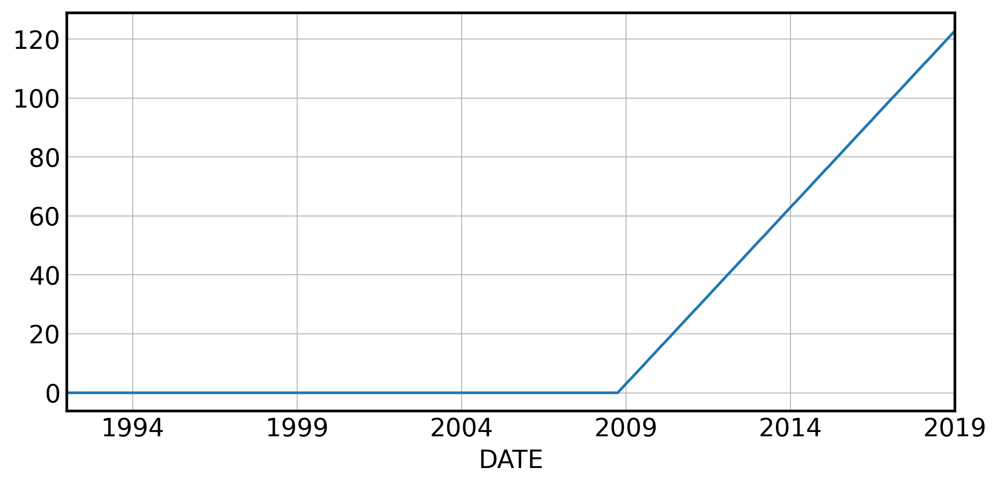

In [ ]:
shipment['days_from_fall_flag'].plot();

In [ ]:
ship = shipment[['UMTMVS','fall_flag','days_from_fall_flag',]].iloc[:209]

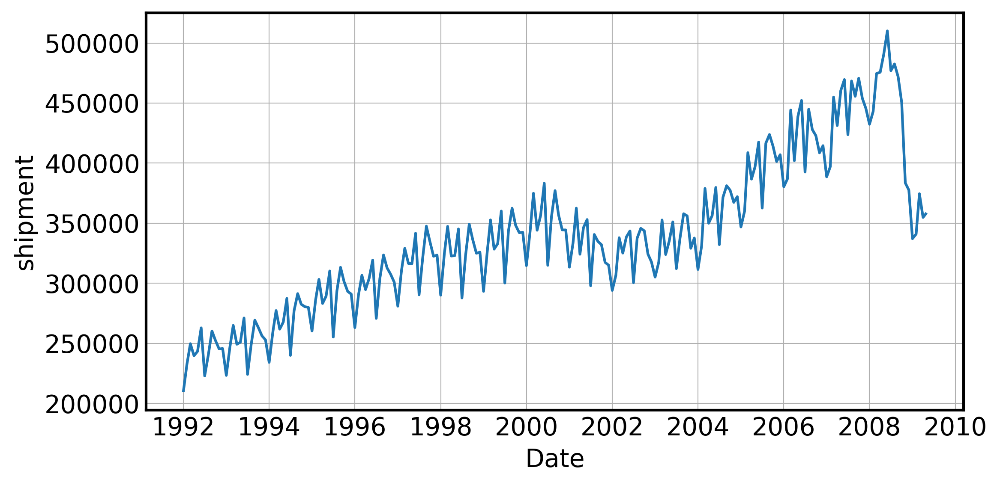

In [ ]:
fig, ax = plt.subplots(1, 1)
ax.plot(ship.index, ship.UMTMVS)
ax.set_xlabel('Date')
ax.set_ylabel('shipment');

## ARIMA

In [ ]:
transformer = BoxCoxTransformer(method='mle',sp=12)

In [ ]:
# проверяем, что в ряду есть тренд
test_trend(ship.UMTMVS)

(True, 0.01, 0.17198808071308586)

In [ ]:
ship['UMTMVS_box'] = transformer.fit_transform(ship['UMTMVS'])
#ship['UMTMVS_box'] = ship['UMTMVS']
ship['UMTMVS_diff12'] = ship['UMTMVS_box'] - ship['UMTMVS_box'].shift(12)
ship['UMTMVS_diff1'] = ship.UMTMVS_diff12 - ship.UMTMVS_diff12.shift(1)

In [ ]:
transformer.lambda_

-0.04362535523801844

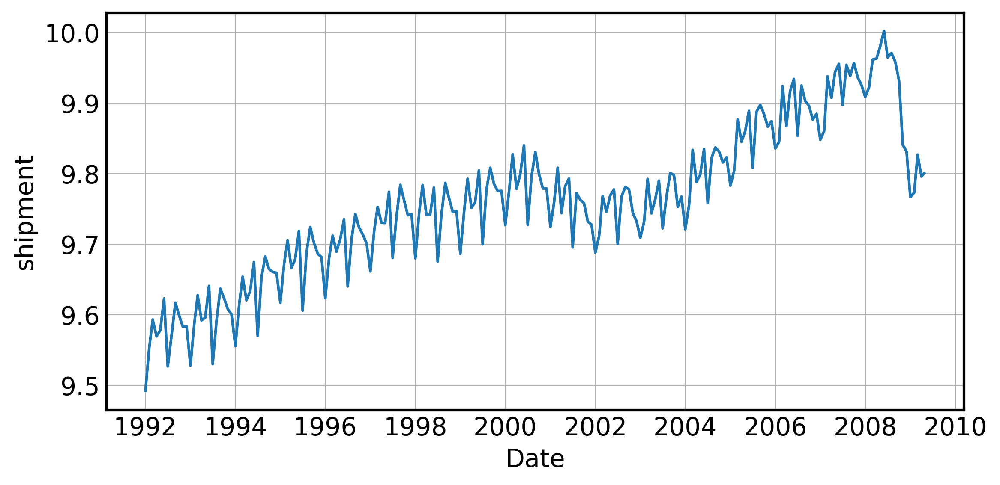

In [ ]:
fig, ax = plt.subplots(1, 1)
ax.plot(ship.index, ship.UMTMVS_box)
ax.set_xlabel('Date')
ax.set_ylabel('shipment');

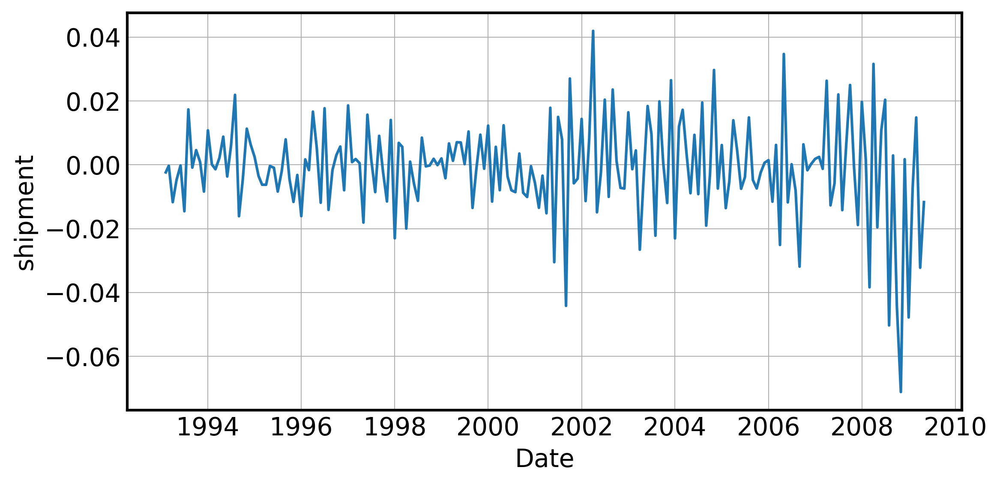

In [ ]:
fig, ax = plt.subplots(1, 1)
ax.plot(ship.index, ship.UMTMVS_diff1)
ax.set_xlabel('Date')
ax.set_ylabel('shipment');

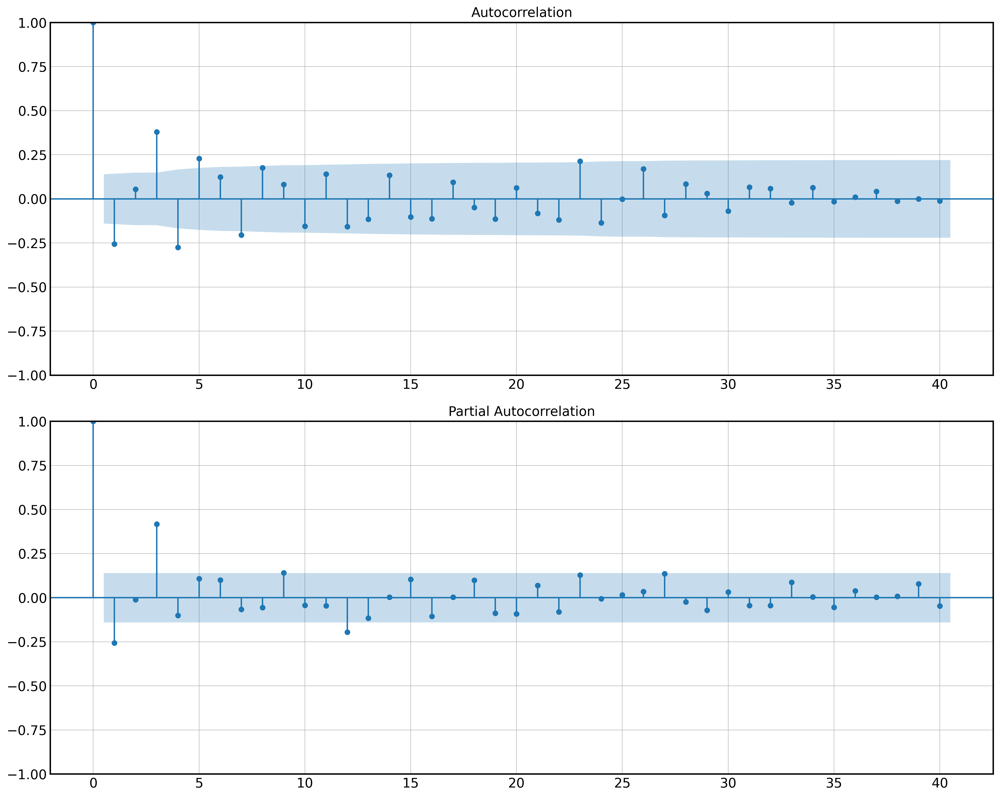

In [ ]:
fig,ax =plt.subplots(2,1,figsize= (15,12)) 
tsaplots.plot_acf(ship.UMTMVS_diff1.dropna(),ax=ax[0],lags =40);
tsaplots.plot_pacf(ship.UMTMVS_diff1.dropna(),ax=ax[1],lags =40);

In [ ]:
# max_p - последний статзначимый лаг в частичной автокореляционной ф-и
# max_P - последний статзначимый сезонный лаг в частичной автокореляционной ф-и
# max_q - последний статзначимый лаг в автокореляционной ф-и
# max_Q - последний статзначимый сезонный лаг в автокореляционной ф-и
_, mod0 = calc_optimum_sarima(ship.UMTMVS_box,
                        max_p = 3,
                        max_P = 1,
                        max_q = 5,
                        max_Q = 0,
                        d = 1,
                        D = 1)

48


100%|██████████| 48/48 [02:17<00:00,  2.86s/it]


In [ ]:
mod0.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                      SARIMAX Results                                      
===========================================================================================
Dep. Variable:                          UMTMVS_box   No. Observations:                  209
Model:             SARIMAX(2, 1, 2)x(1, 1, [], 12)   Log Likelihood                 575.526
Date:                             Thu, 07 Aug 2025   AIC                          -1139.052
Time:                                     19:19:11   BIC                          -1119.383
Sample:                                 01-01-1992   HQIC                         -1131.089
                                      - 05-01-2009                                         
Covariance Type:                               opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -1.1337      0.037    -30.661      0.000      -1.206      -1.061
ar.L2         -0.9568      0.035    -27.559      0.000      -1.025      -0.889
ma.L1          0.9593      0.063     15.322      0.000       0.837       1.082
ma.L2          0.8720      0.055     15.822      0.000       0.764       0.980
ar.S.L12      -0.2865      0.091     -3.133      0.002      -0.466      -0.107
sigma2         0.0002   1.23e-05     13.238      0.000       0.000       0.000
===================================================================================
Ljung-Box (L1) (Q):                   0.00   Jarque-Bera (JB):                63.06
Prob(Q):                              0.98   Prob(JB):                         0.00
Heteroskedasticity (H):               4.43   Skew:                            -0.87
Prob(H) (two-sided):                  0.00   Kurtosis:                         5.17
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

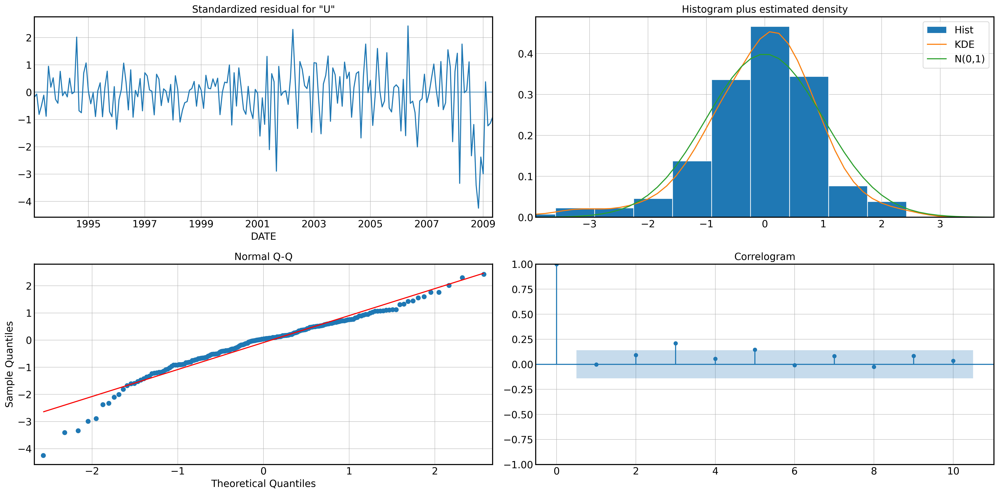

In [ ]:
mod0.plot_diagnostics(figsize=(20, 10));

In [ ]:
d_min = np.min(ship['days_from_fall_flag'])
d_max = np.max(ship['days_from_fall_flag'])
ship['days_from_fall_flag_norm'] = (ship['days_from_fall_flag'] - d_min) / (d_max - d_min)

In [ ]:
fall_mod = sm.OLS(ship.UMTMVS_diff1.dropna(),ship.dropna()[['fall_flag','days_from_fall_flag_norm',]]).fit()

In [ ]:
fall_mod.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:           UMTMVS_diff1   R-squared (uncentered):                   0.096
Model:                            OLS   Adj. R-squared (uncentered):              0.087
Method:                 Least Squares   F-statistic:                              10.35
Date:                Thu, 07 Aug 2025   Prob (F-statistic):                    5.33e-05
Time:                        19:20:33   Log-Likelihood:                          550.83
No. Observations:                 196   AIC:                                     -1098.
Df Residuals:                     194   BIC:                                     -1091.
Df Model:                           2                                                  
Covariance Type:            nonrobust                                                  
============================================================================================
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
fall_flag                   -0.0470      0.012     -3.768      0.000      -0.072      -0.022
days_from_fall_flag_norm     0.0436      0.019      2.243      0.026       0.005       0.082
==============================================================================
Omnibus:                        7.460   Durbin-Watson:                   2.739
Prob(Omnibus):                  0.024   Jarque-Bera (JB):               11.180
Skew:                          -0.186   Prob(JB):                      0.00373
Kurtosis:                       4.109   Cond. No.                         4.75
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

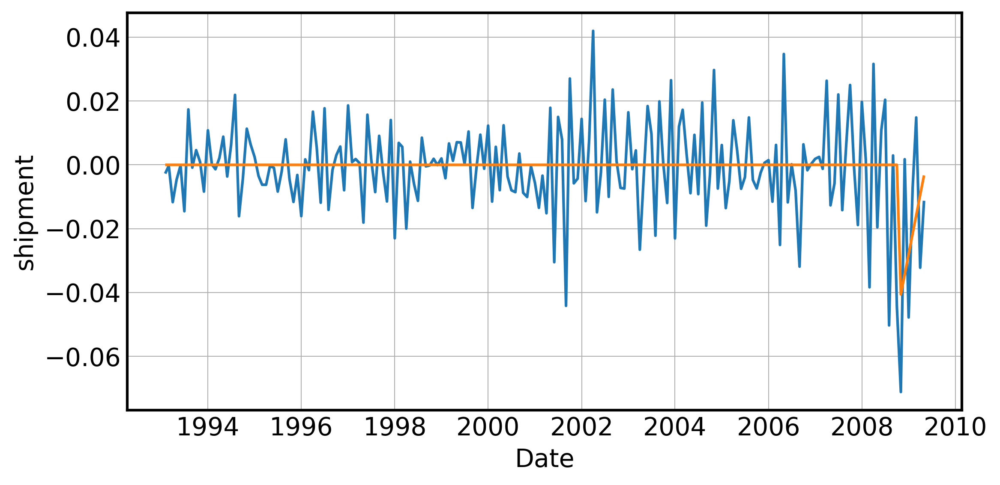

In [ ]:
fig, ax = plt.subplots(1, 1)
ax.plot(ship.dropna().index, ship.UMTMVS_diff1.dropna())
ax.plot(ship.dropna().index, fall_mod.fittedvalues)
ax.set_xlabel('Date')
ax.set_ylabel('shipment');

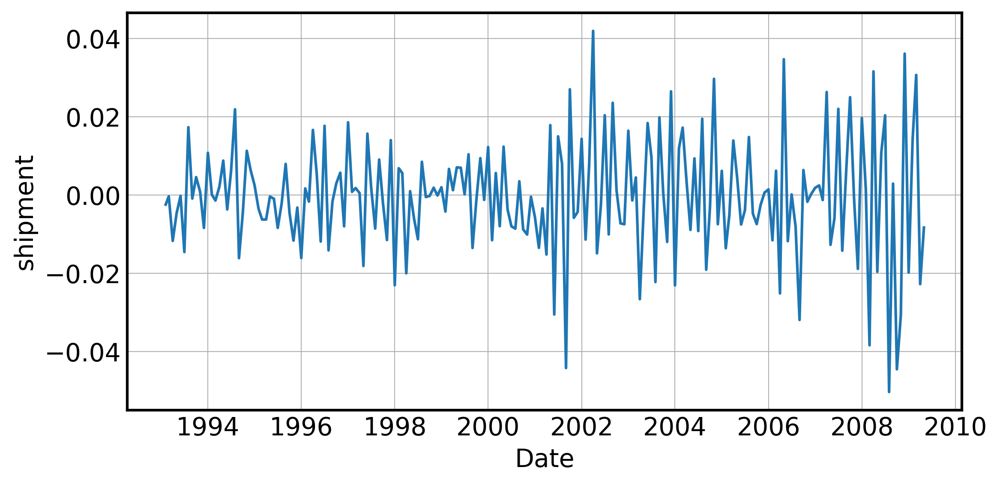

In [ ]:
fig, ax = plt.subplots(1, 1)
ax.plot(ship.dropna().index, ship.dropna().UMTMVS_diff1 - fall_mod.fittedvalues)
ax.set_xlabel('Date')
ax.set_ylabel('shipment');

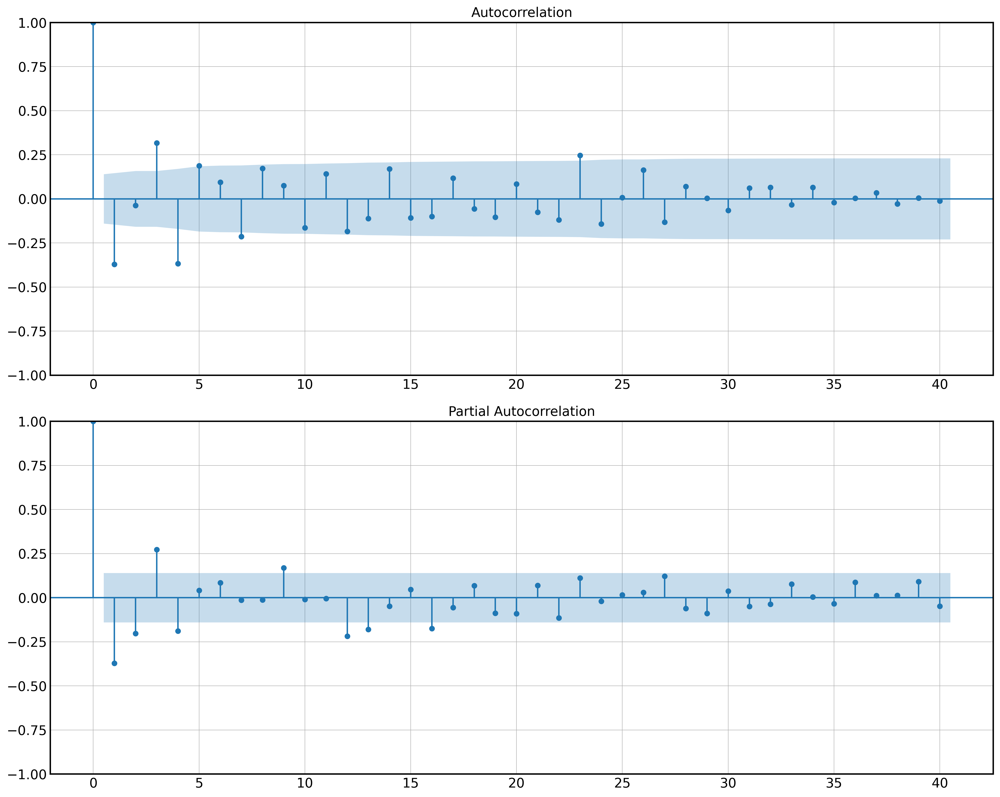

In [ ]:
fig,ax =plt.subplots(2,1,figsize= (15,12)) 
tsaplots.plot_acf(ship.UMTMVS_diff1.dropna()- fall_mod.fittedvalues,ax=ax[0],lags =40);
tsaplots.plot_pacf(ship.UMTMVS_diff1.dropna()- fall_mod.fittedvalues,ax=ax[1],lags =40);

In [ ]:
# max_p - последний статзначимый лаг в частичной автокореляционной ф-и
# max_P - последний статзначимый сезонный лаг в частичной автокореляционной ф-и
# max_q - последний статзначимый лаг в автокореляционной ф-и
# max_Q - последний статзначимый сезонный лаг в автокореляционной ф-и
_, mod = calc_optimum_sarima(ship.UMTMVS_box,
                        max_p = 4,
                        max_P = 1,
                        max_q = 4,
                        max_Q = 0,
                        d = 1,
                        D = 1,
                        X=ship[['fall_flag','days_from_fall_flag_norm',]])

50


100%|██████████| 50/50 [05:48<00:00,  6.97s/it]


In [ ]:
mod.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                      SARIMAX Results                                      
===========================================================================================
Dep. Variable:                          UMTMVS_box   No. Observations:                  209
Model:             SARIMAX(1, 1, 3)x(1, 1, [], 12)   Log Likelihood                 593.144
Date:                             Thu, 07 Aug 2025   AIC                          -1170.288
Time:                                     19:28:05   BIC                          -1144.063
Sample:                                 01-01-1992   HQIC                         -1159.671
                                      - 05-01-2009                                         
Covariance Type:                               opg                                         
============================================================================================
                               coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------
fall_flag                   -0.0685      0.035     -1.984      0.047      -0.136      -0.001
days_from_fall_flag_norm    -0.0946      0.035     -2.705      0.007      -0.163      -0.026
ar.L1                       -0.6099      0.142     -4.282      0.000      -0.889      -0.331
ma.L1                        0.1344      0.133      1.007      0.314      -0.127       0.396
ma.L2                       -0.3091      0.084     -3.679      0.000      -0.474      -0.144
ma.L3                        0.2964      0.078      3.814      0.000       0.144       0.449
ar.S.L12                    -0.3338      0.076     -4.399      0.000      -0.482      -0.185
sigma2                       0.0001   1.16e-05     11.697      0.000       0.000       0.000
===================================================================================
Ljung-Box (L1) (Q):                   0.03   Jarque-Bera (JB):                19.62
Prob(Q):                              0.86   Prob(JB):                         0.00
Heteroskedasticity (H):               3.10   Skew:                            -0.32
Prob(H) (two-sided):                  0.00   Kurtosis:                         4.41
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

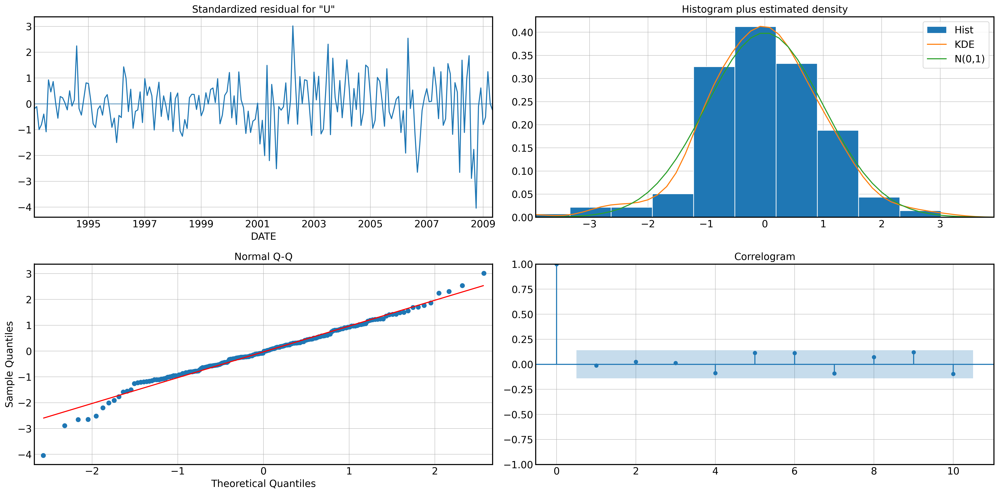

In [ ]:
mod.plot_diagnostics(figsize=(20, 10));

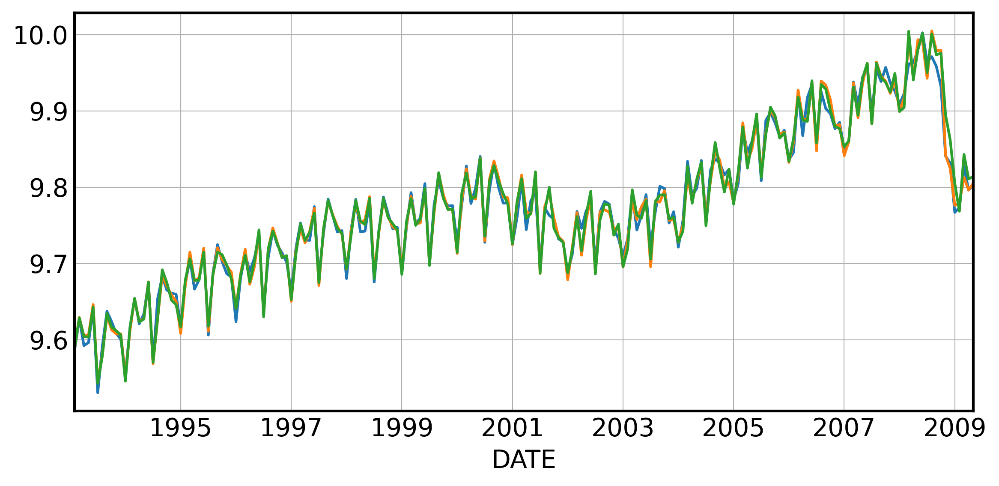

In [ ]:
ship.UMTMVS_box.iloc[13:].plot()
mod.fittedvalues.iloc[13:].plot()
mod0.fittedvalues.iloc[13:].plot();

## UC и EMA

https://www.statsmodels.org/dev/generated/statsmodels.tsa.statespace.structural.UnobservedComponents.html

In [ ]:
from sktime.forecasting.exp_smoothing import ExponentialSmoothing
from sktime.forecasting.structural import UnobservedComponents

In [ ]:
models = [("unobs_deterministic_trend", UnobservedComponents(seasonal=12,level="deterministic trend")),
          ("unobs_local_linear_deterministic_trend",UnobservedComponents(seasonal=12,
                                                                         level="local linear deterministic trend")),
          ("unobs_local_linear_trend",UnobservedComponents( seasonal=12,level="local linear trend"))]

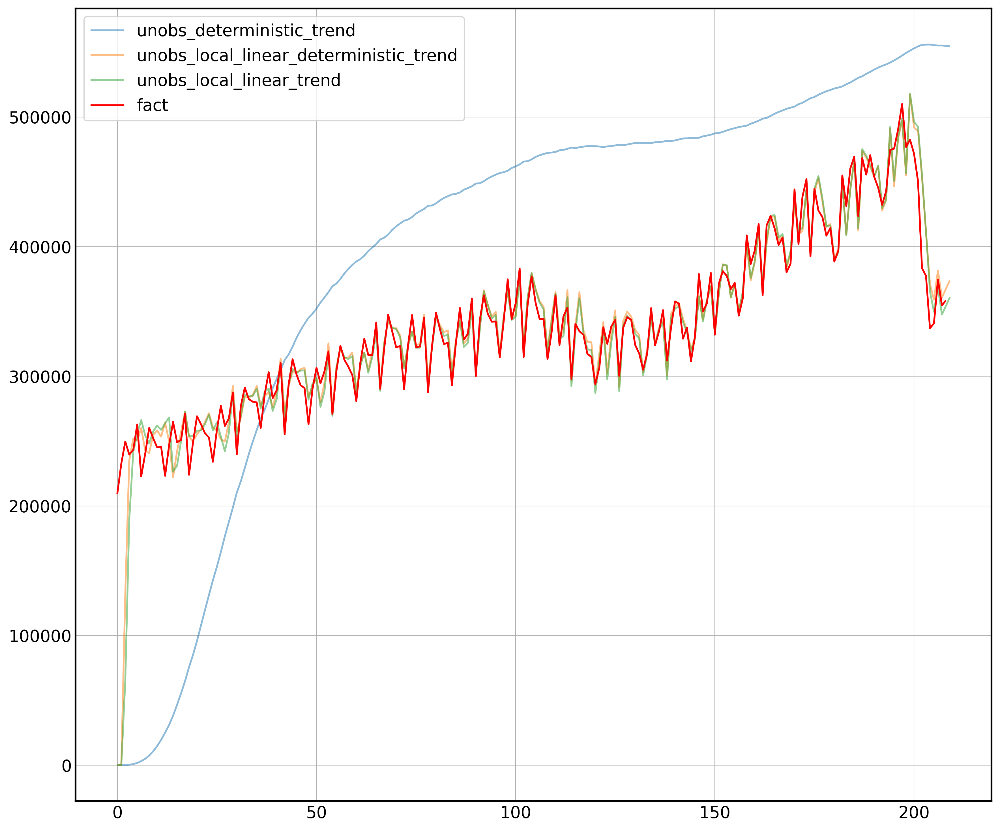

In [ ]:
fig,ax = plt.subplots(1,1,figsize=(12,10))
for label,model in models:
    es1 = model
    es1 = es1.fit(ship.UMTMVS.values);
    ax.plot(es1._forecaster.fit(disp=0).predict(start=0,end= len(ship)),alpha = 0.5,label=label)
ax.plot(ship.UMTMVS.values,c='red',label='fact')
ax.legend();

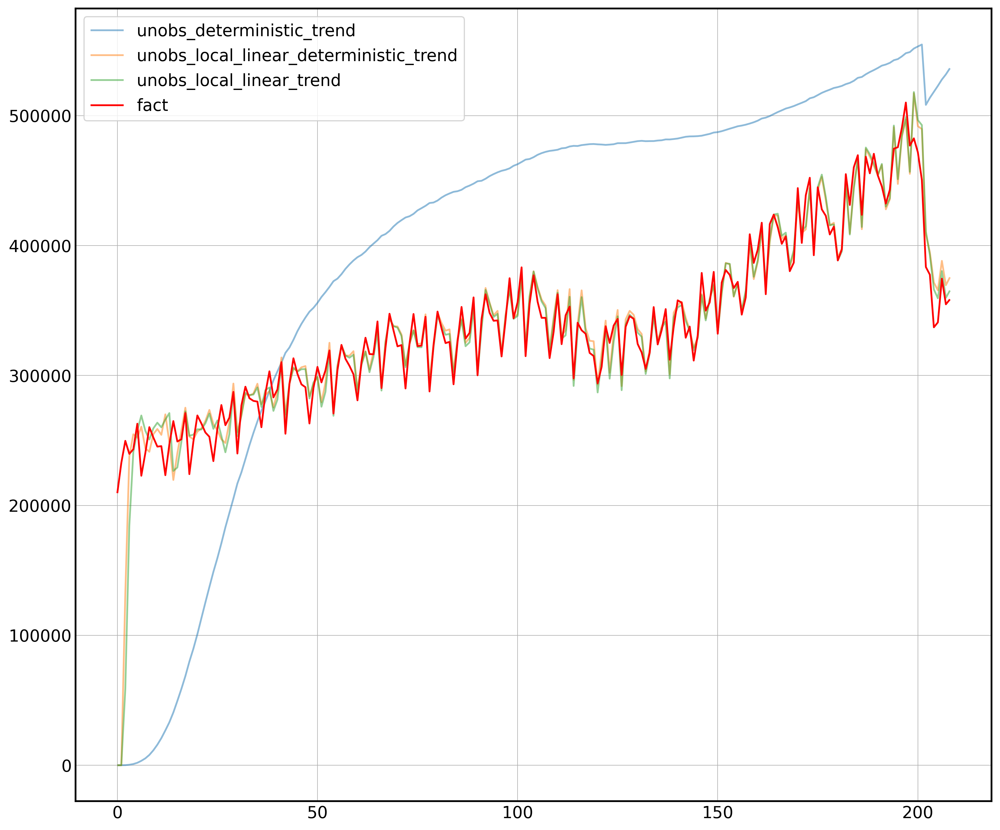

In [ ]:
fig,ax = plt.subplots(1,1,figsize=(12,10))
min_llf = 10e20
min_model = None
for label,model in models:
    es1 = model
    llf_cur = es1._forecaster.fit(disp=0).aicc
    es1 = es1.fit(ship.UMTMVS.values, X=ship[['fall_flag','days_from_fall_flag_norm']].values);
    ax.plot(es1._forecaster.fit(disp=0).predict(start=0,
                                                end= len(ship)-1),
            alpha = 0.5,label=label)
    if llf_cur < min_llf:
        llf_cur = min_llf
        min_model = es1
    
ax.plot(ship.UMTMVS.values,c='red',label='fact')
ax.legend();

In [ ]:
min_model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            Unobserved Components Results                            
=====================================================================================
Dep. Variable:                             y   No. Observations:                  209
Model:                    local linear trend   Log Likelihood               -2113.539
                   + stochastic seasonal(12)   AIC                           4239.077
Date:                       Thu, 07 Aug 2025   BIC                           4258.746
Time:                               19:28:19   HQIC                          4247.040
Sample:                                    0                                         
                                       - 209                                         
Covariance Type:                         opg                                         
====================================================================================
                       coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------------
sigma2.irregular   1.87e+07   6.88e+06      2.718      0.007    5.21e+06    3.22e+07
sigma2.level      2.815e+07   8.62e+06      3.265      0.001    1.13e+07     4.5e+07
sigma2.trend      5.171e+05   5.27e+05      0.981      0.327   -5.16e+05    1.55e+06
sigma2.seasonal   1.456e+07   3.06e+06      4.752      0.000    8.55e+06    2.06e+07
beta.0            -4.92e+04   6542.818     -7.520      0.000    -6.2e+04   -3.64e+04
beta.1            3.152e+04   2.87e+04      1.099      0.272   -2.47e+04    8.77e+04
===================================================================================
Ljung-Box (L1) (Q):                  21.53   Jarque-Bera (JB):                16.71
Prob(Q):                              0.00   Prob(JB):                         0.00
Heteroskedasticity (H):               1.22   Skew:                            -0.23
Prob(H) (two-sided):                  0.43   Kurtosis:                         4.35
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

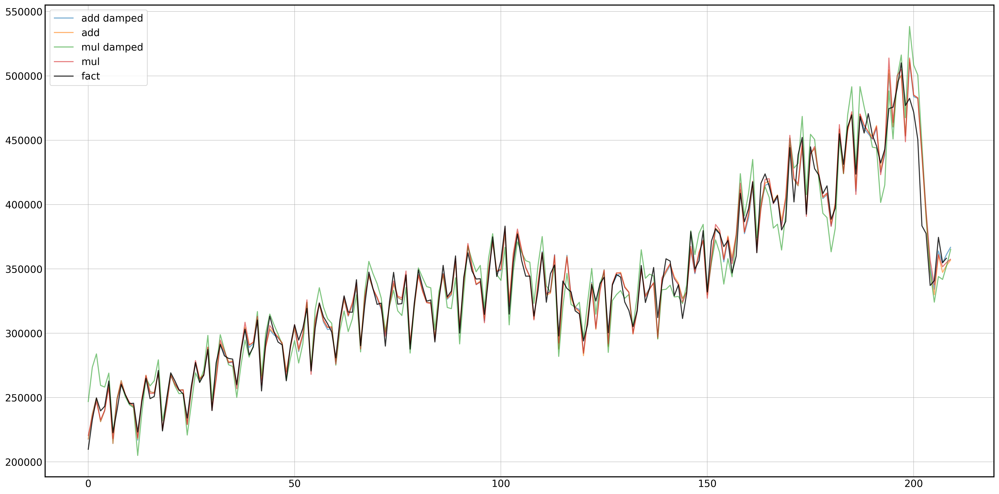

In [ ]:
fig,ax = plt.subplots(1,1,figsize=(20,10))
min_llf = 1e20
min_model = None
for trend, is_damped in product(["add", "mul"],[True,False]):
    es1 = ExponentialSmoothing(trend = trend,
                               seasonal = trend,
                               sp = 12,
                               damped_trend = is_damped,
                               initialization_method='heuristic')
    es1 = es1.fit(ship.UMTMVS.values)
    llf_cur = es1._forecaster.fit().aicc
    ax.plot(es1._forecaster.fit().predict(start=0,end= len(ship)),
             label=trend+(" damped" if is_damped else ""),alpha = 0.6)
    
    if llf_cur < min_llf:
        llf_cur = min_llf
        min_model = es1

ax.plot(ship.UMTMVS.values,alpha = 0.8,c='black',label='fact')
ax.legend();

In [ ]:
min_model

ExponentialSmoothing(initialization_method='heuristic', seasonal='mul', sp=12,
                     trend='mul')

# О кросс-валидации

## Кросс-валидация с sktime

Начнем с временной кросс-валидации. Зададим её в том же виде, как на валидации - по последним 24 месяцам в обучающей выборке будем прогнозировать на 24 месяца вперед с шагом 1

In [ ]:
cv = ExpandingWindowSplitter(fh=1, initial_window=208, step_length=1)
cv1 = SlidingWindowSplitter(fh=1, initial_window=208, step_length=1, window_length= 200)

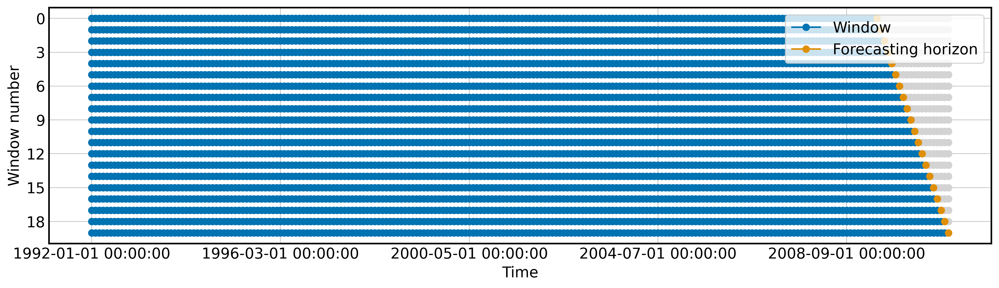

In [ ]:
# построим график нашей валидационной схемы - прогноз на 24 месяца скользящим окном в 1 месяц на последние 2 года
from sktime.utils.plotting import plot_windows

plot_windows(cv, shipment['UMTMVS'].iloc[:228]);

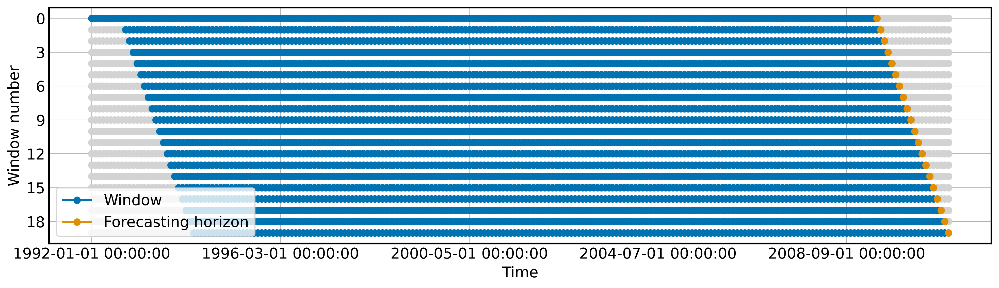

In [ ]:
plot_windows(cv1, shipment['UMTMVS'].iloc[:228]);

In [ ]:
ema = ExponentialSmoothing(sp=12,seasonal ='mul',trend ='mul') 

In [ ]:
dfprogn_ema = evaluate(forecaster=ema, 
              y=shipment['UMTMVS'].iloc[:228].values, 
              cv=cv, 
              strategy="refit", 
              return_data=True)

In [ ]:
dfprogn_ema

,test_MeanAbsolutePercentageError,fit_time,pred_time,len_train_window,cutoff,y_train,y_test,y_pred
0,0.009905,1.217146,0.013145,208,207,0 0 209438.0 1 232679.0 2 ...,0 208 358584.0,0 208 355032.25887
1,0.060493,0.874906,0.010529,209,208,0 0 209438.0 1 232679.0 2 ...,0 209 385206.0,0 209 361903.772428
2,0.059716,0.824256,0.016159,210,209,0 0 209438.0 1 232679.0 2 ...,0 210 358332.0,0 210 336933.831408
3,0.051824,0.861515,0.012583,211,210,0 0 209438.0 1 232679.0 2 ...,0 211 377369.0,0 211 357812.050471
4,0.031342,0.661240,0.011608,212,211,0 0 209438.0 1 232679.0 2 ...,0 212 389504.0,0 212 377296.009921
5,0.004335,0.800463,0.066737,213,212,0 0 209438.0 1 232679.0 2 ...,0 213 389108.0,0 213 387421.306516
6,0.018374,0.781400,0.021349,214,213,0 0 209438.0 1 232679.0 2 ...,0 214 372369.0,0 214 365527.016413
7,0.022491,0.616861,0.031639,215,214,0 0 209438.0 1 232679.0 2 ...,0 215 385999.0,0 215 377317.341835
8,0.002707,0.647910,0.021006,216,215,0 0 209438.0 1 232679.0 2 ...,0 216 359013.0,0 216 359984.822215
9,0.023416,0.696409,0.026903,217,216,0 0 209438.0 1 232679.0 2 ...,0 217 362439.0,0 217 370925.874872


In [ ]:
# в колонках  y_train,y_test,y_pred лежат pd.Series, для удобства приводим их к обычным числам
dfprogn_ema['y_pred'] = dfprogn_ema['y_pred'].apply(lambda x: x.values[0]) 
dfprogn_ema['y_test'] = dfprogn_ema['y_test'].apply(lambda x: x.values[0]) 
dfprogn_ema['resid'] = dfprogn_ema['y_pred'] - dfprogn_ema['y_test']

In [ ]:
metrics_report(unsqueeze_array(dfprogn_ema['y_test'].values), unsqueeze_array(dfprogn_ema['y_pred'].values))

,mean,median,quan_75,quan_95,std
maes,9533.510754,8905.001510,12739.968492,21493.371541,6554.443471
maes_zero,22595.100000,25917.000000,32810.800000,37816.000000,11881.470046
mapes,2.432174,2.295370,3.195553,5.975488,1.742154
mapes_zero,5.749645,6.503652,7.697482,10.546298,3.162906
r2,0.795702,0.795702,0.795702,0.795702,0.795702


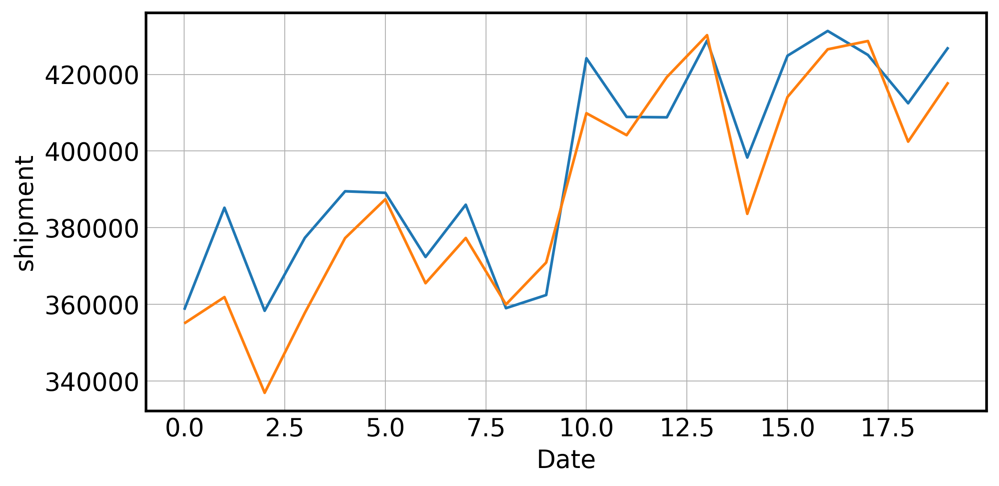

In [ ]:
fig, ax = plt.subplots(1, 1)
ax.plot( dfprogn_ema['y_test'])
ax.plot( dfprogn_ema['y_pred'])
ax.set_xlabel('Date')
ax.set_ylabel('shipment');

In [ ]:
uc = UnobservedComponents(level='local linear trend',seasonal=12)

In [ ]:
dfprogn_uc = evaluate(forecaster=uc, 
              y=shipment['UMTMVS'].iloc[:228].values, 
              cv=cv, 
              strategy="refit", 
              return_data=True)

In [ ]:
dfprogn_uc

,test_MeanAbsolutePercentageError,fit_time,pred_time,len_train_window,cutoff,y_train,y_test,y_pred
0,0.006803,0.734270,0.011958,208,207,0 0 209438.0 1 232679.0 2 ...,0 208 358584.0,0 208 356144.509767
1,0.062552,0.556445,0.012505,209,208,0 0 209438.0 1 232679.0 2 ...,0 209 385206.0,0 209 361110.615967
2,0.125247,0.464270,0.007598,210,209,0 0 209438.0 1 232679.0 2 ...,0 210 358332.0,0 210 313452.146696
3,0.022251,0.518616,0.008654,211,210,0 0 209438.0 1 232679.0 2 ...,0 211 377369.0,0 211 368972.026578
4,0.028895,0.544220,0.017575,212,211,0 0 209438.0 1 232679.0 2 ...,0 212 389504.0,0 212 378249.178334
5,0.015617,0.960340,0.022203,213,212,0 0 209438.0 1 232679.0 2 ...,0 213 389108.0,0 213 395184.782777
6,0.049152,0.371636,0.013981,214,213,0 0 209438.0 1 232679.0 2 ...,0 214 372369.0,0 214 354066.177212
7,0.030978,0.432002,0.007681,215,214,0 0 209438.0 1 232679.0 2 ...,0 215 385999.0,0 215 374041.689385
8,0.009332,0.375752,0.008478,216,215,0 0 209438.0 1 232679.0 2 ...,0 216 359013.0,0 216 355662.869405
9,0.017117,1.069426,0.010110,217,216,0 0 209438.0 1 232679.0 2 ...,0 217 362439.0,0 217 368642.891996


In [ ]:
# в колонках  y_train,y_test,y_pred лежат pd.Series, для удобства приводим их к обычным числам
dfprogn_uc['y_pred'] = dfprogn_uc['y_pred'].apply(lambda x: x.values[0]) 
dfprogn_uc['y_test'] = dfprogn_uc['y_test'].apply(lambda x: x.values[0]) 
dfprogn_uc['resid'] = dfprogn_uc['y_pred'] - dfprogn_uc['y_test']

In [ ]:
metrics_report(unsqueeze_array(dfprogn_uc['y_test'].values), unsqueeze_array(dfprogn_uc['y_pred'].values))

,mean,median,quan_75,quan_95,std
maes,10694.455760,8102.115015,12273.446505,25134.607497,10477.812949
maes_zero,22595.100000,25917.000000,32810.800000,37816.000000,11881.470046
mapes,2.755839,1.916637,3.131693,6.568667,2.856330
mapes_zero,5.749645,6.503652,7.697482,10.546298,3.162906
r2,0.660797,0.660797,0.660797,0.660797,0.660797


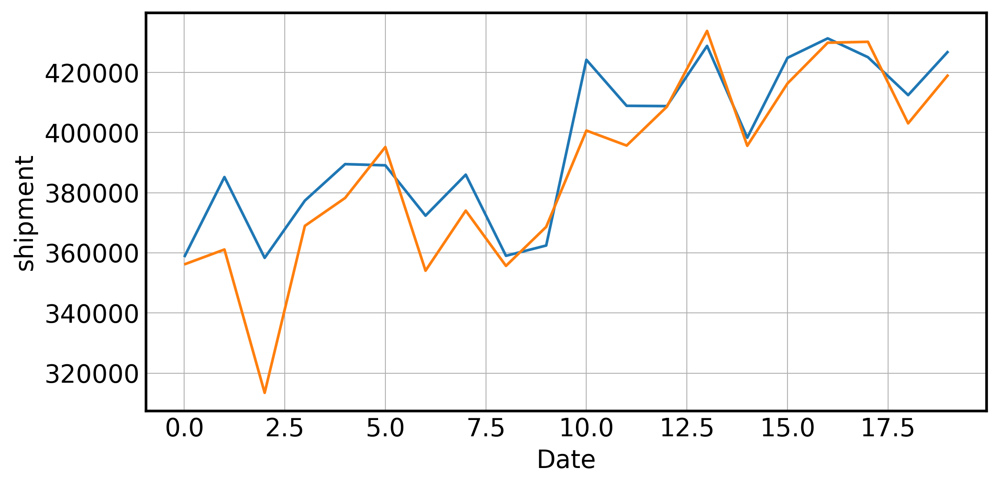

In [ ]:
fig, ax = plt.subplots(1, 1)
ax.plot( dfprogn_uc['y_test'])
ax.plot( dfprogn_uc['y_pred'])
ax.set_xlabel('Date')
ax.set_ylabel('shipment');

In [ ]:
ucf = UnobservedComponents(level='local linear trend',seasonal=12)

In [ ]:
dfprogn_ucf = evaluate(forecaster=ucf, 
              y=shipment['UMTMVS'].iloc[:228].values, 
              X=shipment[['fall_flag']].iloc[:228].values,         
              cv=cv, 
              strategy="refit", 
              return_data=True)

In [ ]:
dfprogn_ucf

,test_MeanAbsolutePercentageError,fit_time,pred_time,len_train_window,cutoff,y_train,y_test,y_pred
0,0.007668,0.491901,0.014908,208,207,0 0 209438.0 1 232679.0 2 ...,0 208 358584.0,0 208 361333.535112
1,0.047813,0.682340,0.014621,209,208,0 0 209438.0 1 232679.0 2 ...,0 209 385206.0,0 209 366788.185686
2,0.068316,0.864765,0.045171,210,209,0 0 209438.0 1 232679.0 2 ...,0 210 358332.0,0 210 333852.070302
3,0.014855,0.618877,0.023335,211,210,0 0 209438.0 1 232679.0 2 ...,0 211 377369.0,0 211 371763.273195
4,0.032248,0.695315,0.045045,212,211,0 0 209438.0 1 232679.0 2 ...,0 212 389504.0,0 212 376943.126045
5,0.005808,0.936586,0.018249,213,212,0 0 209438.0 1 232679.0 2 ...,0 213 389108.0,0 213 386848.164976
6,0.006061,0.715672,0.015255,214,213,0 0 209438.0 1 232679.0 2 ...,0 214 372369.0,0 214 370111.966062
7,0.029034,0.652890,0.017523,215,214,0 0 209438.0 1 232679.0 2 ...,0 215 385999.0,0 215 374792.086088
8,0.006927,0.476461,0.015883,216,215,0 0 209438.0 1 232679.0 2 ...,0 216 359013.0,0 216 356526.141056
9,0.016193,0.491570,0.016750,217,216,0 0 209438.0 1 232679.0 2 ...,0 217 362439.0,0 217 368307.988297


In [ ]:
# в колонках  y_train,y_test,y_pred лежат pd.Series, для удобства приводим их к обычным числам
dfprogn_ucf['y_pred'] = dfprogn_ucf['y_pred'].apply(lambda x: x.values[0]) 
dfprogn_ucf['y_test'] = dfprogn_ucf['y_test'].apply(lambda x: x.values[0]) 
dfprogn_ucf['resid'] = dfprogn_ucf['y_pred'] - dfprogn_ucf['y_test']

In [ ]:
metrics_report(unsqueeze_array(dfprogn_ucf['y_test'].values), unsqueeze_array(dfprogn_ucf['y_pred'].values))

,mean,median,quan_75,quan_95,std
maes,8424.849591,6122.247102,12241.376656,23075.687680,7044.251573
maes_zero,22595.100000,25917.000000,32810.800000,37816.000000,11881.470046
mapes,2.139188,1.582508,3.003652,5.492816,1.825173
mapes_zero,5.749645,6.503652,7.697482,10.546298,3.162906
r2,0.816771,0.816771,0.816771,0.816771,0.816771


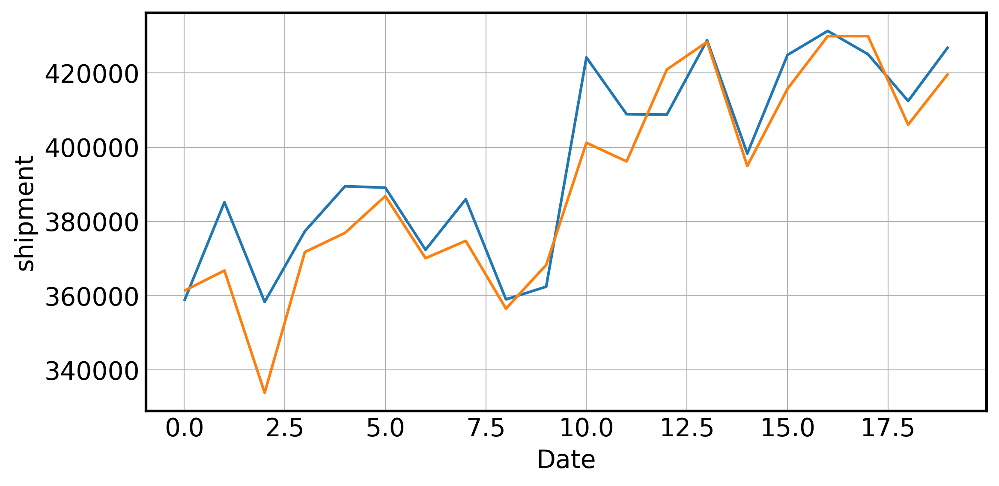

In [ ]:
fig, ax = plt.subplots(1, 1)
ax.plot( dfprogn_ucf['y_test'])
ax.plot( dfprogn_ucf['y_pred'])
ax.set_xlabel('Date')
ax.set_ylabel('shipment');

In [ ]:
from sktime.forecasting.compose import TransformedTargetForecaster
from sktime.forecasting.sarimax import SARIMAX
from sktime.transformations.series.boxcox import BoxCoxTransformer

In [ ]:
forecaster_arima = TransformedTargetForecaster(
    steps=[
        ("box_cox", BoxCoxTransformer(method='mle',sp=12)),
        ("forecaster", SARIMAX((3, 1,0),(1, 1, 0, 12))),
    ]
)

In [ ]:
dfprogn_arima = evaluate(forecaster=forecaster_arima, 
              y=shipment['UMTMVS'].iloc[:228].values,       
              cv=cv, 
              strategy="refit", 
              return_data=True)

In [ ]:
dfprogn_arima

,test_MeanAbsolutePercentageError,fit_time,pred_time,len_train_window,cutoff,y_train,y_test,y_pred
0,0.035535,10.565425,0.030461,208,207,0 0 209438.0 1 232679.0 2 ...,0 208 358584.0,0 208 371326.239957
1,0.033341,11.738999,0.038788,209,208,0 0 209438.0 1 232679.0 2 ...,0 209 385206.0,0 209 372362.913256
2,0.036934,10.110902,0.064380,210,209,0 0 209438.0 1 232679.0 2 ...,0 210 358332.0,0 210 345097.276236
3,0.027007,7.481113,0.045198,211,210,0 0 209438.0 1 232679.0 2 ...,0 211 377369.0,0 211 367177.458403
4,0.042417,6.783034,0.019827,212,211,0 0 209438.0 1 232679.0 2 ...,0 212 389504.0,0 212 372982.279912
5,0.031673,4.503621,0.028555,213,212,0 0 209438.0 1 232679.0 2 ...,0 213 389108.0,0 213 376783.647792
6,0.068154,3.611763,0.019774,214,213,0 0 209438.0 1 232679.0 2 ...,0 214 372369.0,0 214 346990.55187
7,0.040919,7.253634,0.018306,215,214,0 0 209438.0 1 232679.0 2 ...,0 215 385999.0,0 215 370204.124784
8,0.002647,5.440203,0.019973,216,215,0 0 209438.0 1 232679.0 2 ...,0 216 359013.0,0 216 358062.772774
9,0.048254,3.882359,0.042933,217,216,0 0 209438.0 1 232679.0 2 ...,0 217 362439.0,0 217 379928.079983


In [ ]:
# в колонках  y_train,y_test,y_pred лежат pd.Series, для удобства приводим их к обычным числам
dfprogn_arima['y_pred'] = dfprogn_arima['y_pred'].apply(lambda x: x.values[0]) 
dfprogn_arima['y_test'] = dfprogn_arima['y_test'].apply(lambda x: x.values[0]) 
dfprogn_arima['resid'] = dfprogn_arima['y_pred'] - dfprogn_arima['y_test']

In [ ]:
metrics_report(unsqueeze_array(dfprogn_arima['y_test'].values), unsqueeze_array(dfprogn_arima['y_pred'].values))

,mean,median,quan_75,quan_95,std
maes,12370.908209,12792.663350,16763.560061,21677.261792,6966.385847
maes_zero,22595.100000,25917.000000,32810.800000,37816.000000,11881.470046
mapes,3.137780,3.443785,4.288213,5.099967,1.785032
mapes_zero,5.749645,6.503652,7.697482,10.546298,3.162906
r2,0.691083,0.691083,0.691083,0.691083,0.691083


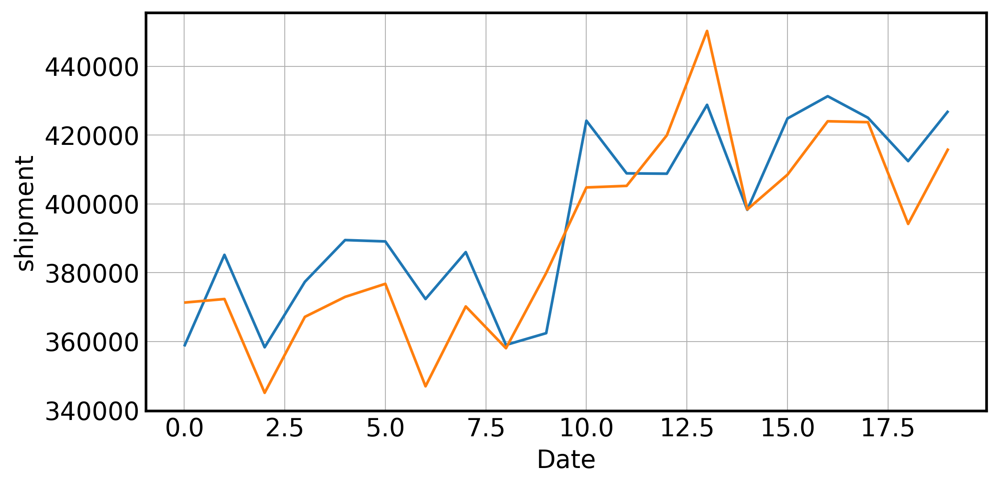

In [ ]:
fig, ax = plt.subplots(1, 1)
ax.plot(dfprogn_arima['y_test'])
ax.plot( dfprogn_arima['y_pred'])
ax.set_xlabel('Date')
ax.set_ylabel('shipment');

In [ ]:
shipment['days_from_fall_flag_norm'] = (shipment['days_from_fall_flag'] - d_min) / (d_max - d_min)

In [ ]:
forecaster_arima = TransformedTargetForecaster(
    steps=[
        ("box_cox", BoxCoxTransformer(method='mle',sp=12)),
        ("forecaster", SARIMAX((2, 1,2),(1, 1, 0, 12))),
    ]
)

In [ ]:
dfprogn_arimaf = evaluate(forecaster=forecaster_arima, 
              y=shipment['UMTMVS'].iloc[:228].values, 
              X=shipment[['fall_flag','days_from_fall_flag_norm']].iloc[:228].values, 
              cv=cv, 
              strategy="refit", 
              return_data=True)

In [ ]:
# в колонках  y_train,y_test,y_pred лежат pd.Series, для удобства приводим их к обычным числам
dfprogn_arimaf['y_pred'] = dfprogn_arimaf['y_pred'].apply(lambda x: x.values[0]) 
dfprogn_arimaf['y_test'] = dfprogn_arimaf['y_test'].apply(lambda x: x.values[0]) 
dfprogn_arimaf['resid'] = dfprogn_arimaf['y_pred'] - dfprogn_arimaf['y_test']

In [ ]:
metrics_report(unsqueeze_array(dfprogn_arimaf['y_test'].values), unsqueeze_array(dfprogn_arimaf['y_pred'].values))

,mean,median,quan_75,quan_95,std
maes,12825.776817,11849.145622,18319.929295,23484.199286,7507.292930
maes_zero,22595.100000,25917.000000,32810.800000,37816.000000,11881.470046
mapes,3.251319,3.084974,4.804481,6.092820,1.940848
mapes_zero,5.749645,6.503652,7.697482,10.546298,3.162906
r2,0.661766,0.661766,0.661766,0.661766,0.661766


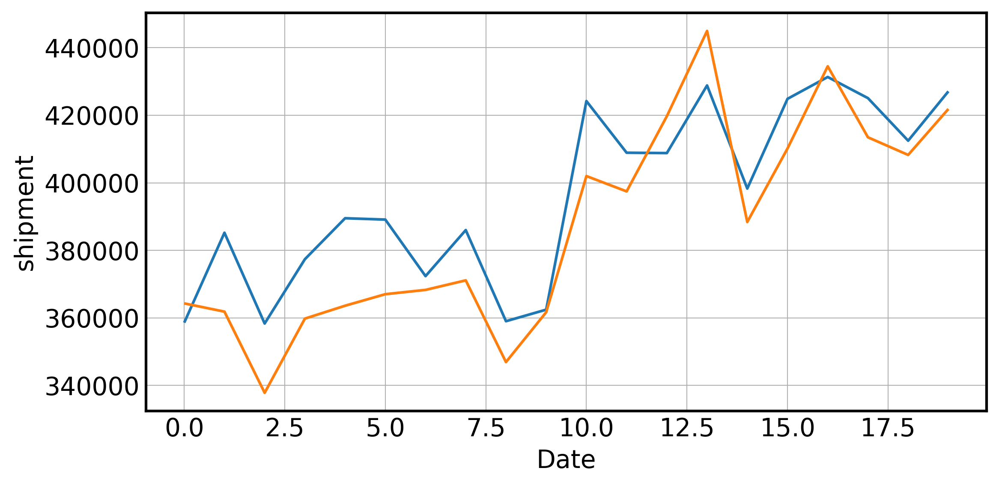

In [ ]:
fig, ax = plt.subplots(1, 1)
ax.plot(dfprogn_arimaf['y_test'])
ax.plot( dfprogn_arimaf['y_pred'])
ax.set_xlabel('Date')
ax.set_ylabel('shipment');

## Кастомная валидация с sktime

Теперь оценим качество на кросс-валидации для prophet. Попробуем задать следующую кросс-валидацию - с шагом 1 месяц (т.е. с переменным шагом по дням - 30/31/28 дней) и с разницей между концом обучения и месяцем предикта - 1 месяц (т.е. по данным декабря прогнозируем на февраль). К сожалению, в модуле ExpandingWindowSplitter из библиотеки sktime нельзя сделать сплитер с разными шагами по времени, поэтому мы напишем свой, совместимый с функцией evaluate из той же библиотеки sktime.

In [ ]:
from sktime.forecasting.base import ForecastingHorizon
from sktime.forecasting.fbprophet import Prophet as prophet_sktime

In [ ]:
from datetime import datetime
from typing import Union

from pandas.tseries.frequencies import to_offset
from sktime.split.base._base_splitter import BaseSplitter


class TimeseriesSplit(BaseSplitter):
    def __init__(self,
                 start_dt: datetime,
                 end_dt: datetime,
                 freq: str,
                 h:int,
                 n_splits: int=None,
                 split_step: int = None,
                 gap = 0):
        """
        Класс для временной кросс-валидации по заданной частоте freq.
        Помимо частоты, задается либо число шагов валидации (n_splits), 
        либо шаг валидации (split_step)

        :param start_dt: дата, откуда начинаем валидацию
        :param end_dt: дата, где валидация заканчивается 
        :param freq: pandas offset frequency
        (см. https://pandas.pydata.org/pandas-docs/version/1.5/user_guide/timeseries.html#offset-aliases)
        :param h: горизонт прогнозирования 
        :param n_splits: число шагов валидации 
        :param split_step: шаг валидации
        :param gap: промежуток между концом обучения и датой валидации
        :return:
        
        """
        
        
        self.start_dt = start_dt
        self.end_dt = end_dt
        
        self.freq = freq
        
        if n_splits is None and split_step is None:
            raise "You should either define n_splits or split_step"
        
        if n_splits is None:
            #кол-во сплитов=кол-во дат между start_dt и end_dt с частотой freq/шаг валидации
            self.n_splits = int(np.ceil(1.0*len(pd.date_range(start=start_dt,
                                                              end=end_dt,
                                                              freq=freq))/split_step))
            self.split_step = split_step
        else:
            #шаг валидации=кол-во дат между start_dt и end_dt с частотой freq/кол-во сплитов
            self.split_step = int(np.ceil(1.0*len(pd.date_range(start=start_dt,
                                                                end=end_dt,
                                                                freq=freq))/n_splits))
            self.n_splits = n_splits
        
        self.gap = gap
        self.h = h
        self.fh = None

    # split для sklearn - def split(self, X, y, groups = None):
    def split(self, X, y=None, groups=None):
        """
        Функция-генератор разбиения выборки на train и test
        """
        if isinstance(X,pd.DatetimeIndex):
                dates_index = X
        else:
                dates_index = pd.to_datetime(X.index)
                
        for i in range(self.n_splits):
            # в обучение попадает от start_dt до текущего шага - гап
            dt_train = self.start_dt + to_offset(self.freq)*(i*self.split_step-self.gap)
            # в тест - от текущего шага до текущего шага + горизонт прогнозирования
            dt_start_test = dt_train + to_offset(self.freq)*(self.gap)
            dt_end_test = dt_train + to_offset(self.freq)*(self.h+self.gap)
            
            # возвращаем индексы в масивах
            trix = np.where(dates_index<dt_train)[0]
            tsix = np.where((dates_index>=dt_start_test) &\
                            (dates_index<dt_end_test))[0]
            
            
            yield trix, tsix

    def print_dates(self,y):
        """
        Вспомогательная функция для проверки корректности алгоритма
        """
        
        dates_index = pd.to_datetime(y.index)
        for i in range(self.n_splits):
            # в обучение попадает от start_dt до текущего шага - гап
            dt_train = self.start_dt + to_offset(self.freq)*(i*self.split_step-self.gap)
            # в тест - от текущего шага до текущего шага + горизонт прогнозирования
            dt_start_test = dt_train + to_offset(self.freq)*(self.gap)
            dt_end_test = dt_train + to_offset(self.freq)*(self.h+self.gap)
            
            # возвращаем индексы в масивах
            trix = np.where(dates_index<dt_train)[0]
            tsix = np.where((dates_index>=dt_start_test) &\
                            (dates_index<dt_end_test))[0]
            
            print (dt_train,  dt_start_test, dt_end_test, len(trix), len(tsix))
    
    
    
    def get_n_splits(self, X, y, groups=None):
        """
        Вспомогательная функция для совместимости с sklearn
        """
        return self.n_splits

In [ ]:
tss = TimeseriesSplit(pd.to_datetime('2017-06-01'),
                pd.to_datetime('2017-08-15'),
                freq='MS',
                h=1,
                split_step = 1,
                gap=1)

In [ ]:
transactions_series = transactions.set_index("ds").resample("D").sum().y

In [ ]:
# прогнозируем на месяц позже окончания обучения
tss.print_dates(transactions_series,)

2017-05-01 00:00:00 2017-06-01 00:00:00 2017-07-01 00:00:00 1581 30
2017-06-01 00:00:00 2017-07-01 00:00:00 2017-08-01 00:00:00 1612 31
2017-07-01 00:00:00 2017-08-01 00:00:00 2017-09-01 00:00:00 1642 15


In [ ]:
forecaster = prophet_sktime()

In [ ]:
# убираем ненужные принты
import warnings

warnings.simplefilter("ignore")
warnings.simplefilter("ignore", DeprecationWarning)
warnings.simplefilter("ignore", FutureWarning)

import logging

logging.getLogger('prophet').setLevel(logging.ERROR)

In [ ]:
df1 = evaluate(forecaster=forecaster, 
              y=transactions_series, 
              cv=tss, 
              strategy="refit", 
              return_data=True)

20:16:18 - cmdstanpy - INFO - Chain [1] start processing
20:16:18 - cmdstanpy - INFO - Chain [1] done processing
20:16:19 - cmdstanpy - INFO - Chain [1] start processing
20:16:19 - cmdstanpy - INFO - Chain [1] done processing
20:16:19 - cmdstanpy - INFO - Chain [1] start processing
20:16:20 - cmdstanpy - INFO - Chain [1] done processing


In [ ]:
df1.head()

,test_MeanAbsolutePercentageError,fit_time,pred_time,len_train_window,cutoff,y_train,y_test,y_pred
0,0.044040,0.643454,0.093614,1581,2017-04-30,ds 2013-01-01 770 2013-01-02 93215 2...,ds 2017-06-01 90171 2017-06-02 91840 2...,2017-06-01 77839.406859 2017-06-02 82755...
1,0.038566,0.567592,0.092684,1612,2017-05-31,ds 2013-01-01 770 2013-01-02 93215 201...,ds 2017-07-01 108993 2017-07-02 104392 2...,2017-07-01 99037.893932 2017-07-02 924...
2,0.053595,0.919497,0.093106,1642,2017-06-30,ds 2013-01-01 770 2013-01-02 93215 201...,ds 2017-08-01 92083 2017-08-02 93023 2...,2017-08-01 83089.428003 2017-08-02 836...


In [ ]:
# убеждаемся, что временные промежутки указаны верно
df1.iloc[0].y_train.tail()

ds
2017-04-26     84709
2017-04-27     78971
2017-04-28     87474
2017-04-29    104870
2017-04-30     96514
Freq: D, Name: y, dtype: int64

In [ ]:
df1y_test = pd.concat([x for x in df1.y_test.values])
df1y_pred = pd.concat([x for x in df1.y_pred.values])

оценка качества модели - медиана апе меньше 4%

In [ ]:
metrics_report(df1y_test,
                   df1y_pred)

,mean,median,quan_75,quan_95,std
maes,4040.212580,2990.273071,5932.235652,10713.161456,3642.800646
maes_zero,6483.183518,6155.434211,9012.717105,15711.815789,4862.420169
mapes,4.369279,3.232788,6.593827,11.452001,3.675356
mapes_zero,7.137938,7.092850,10.172814,15.410483,4.850022
r2,0.549923,0.549923,0.549923,0.549923,0.549923


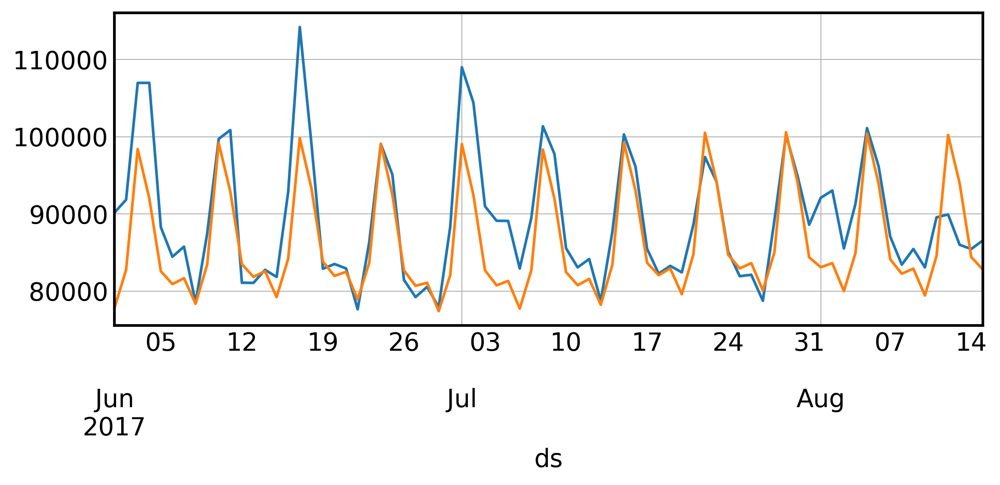

In [ ]:
df1y_test.plot()
df1y_pred.plot();

давайте проверим, улучшилось ли качество на тестовой выборке после изменения сезонностей и внесения праздников

In [ ]:
forecaster = prophet_sktime(add_seasonality = {'name':'monthly', 
                                              'period':30.5, 
                                              'fourier_order':5},
                           changepoint_prior_scale=2.5, 
                            holidays=holidays,
                            seasonality_prior_scale=20.0
                           )

In [ ]:
df2 = evaluate(forecaster=forecaster, 
              y=transactions_series, 
              cv=tss, 
              strategy="refit", 
              return_data=True)

20:16:48 - cmdstanpy - INFO - Chain [1] start processing
20:16:50 - cmdstanpy - INFO - Chain [1] done processing
20:16:52 - cmdstanpy - INFO - Chain [1] start processing
20:16:55 - cmdstanpy - INFO - Chain [1] done processing
20:16:56 - cmdstanpy - INFO - Chain [1] start processing
20:17:00 - cmdstanpy - INFO - Chain [1] done processing


In [ ]:
df2.head()

,test_MeanAbsolutePercentageError,fit_time,pred_time,len_train_window,cutoff,y_train,y_test,y_pred
0,0.033701,3.648408,0.596859,1581,2017-04-30,ds 2013-01-01 770 2013-01-02 93215 2...,ds 2017-06-01 90171 2017-06-02 91840 2...,2017-06-01 81386.260276 2017-06-02 873...
1,0.021589,3.906846,0.685853,1612,2017-05-31,ds 2013-01-01 770 2013-01-02 93215 201...,ds 2017-07-01 108993 2017-07-02 104392 2...,2017-07-01 101225.108204 2017-07-02 969...
2,0.036096,4.084005,0.437851,1642,2017-06-30,ds 2013-01-01 770 2013-01-02 93215 201...,ds 2017-08-01 92083 2017-08-02 93023 2...,2017-08-01 85263.796358 2017-08-02 871...


In [ ]:
df2y_test = pd.concat([x for x in df2.y_test.values])
df2y_pred = pd.concat([x for x in df2.y_pred.values])

смогли уменьшить погрешность почти в 2 раза!

In [ ]:
metrics_report(df1y_test,df1y_pred)

,mean,median,quan_75,quan_95,std
maes,4040.212580,2990.273071,5932.235652,10713.161456,3642.800646
maes_zero,6483.183518,6155.434211,9012.717105,15711.815789,4862.420169
mapes,4.369279,3.232788,6.593827,11.452001,3.675356
mapes_zero,7.137938,7.092850,10.172814,15.410483,4.850022
r2,0.549923,0.549923,0.549923,0.549923,0.549923


In [ ]:
metrics_report(df2y_test,df2y_pred)

,mean,median,quan_75,quan_95,std
maes,2713.224966,1641.058717,3700.263798,8169.093699,2811.222639
maes_zero,6483.183518,6155.434211,9012.717105,15711.815789,4862.420169
mapes,2.923329,1.792090,4.117564,9.294902,2.826626
mapes_zero,7.137938,7.092850,10.172814,15.410483,4.850022
r2,0.768058,0.768058,0.768058,0.768058,0.768058


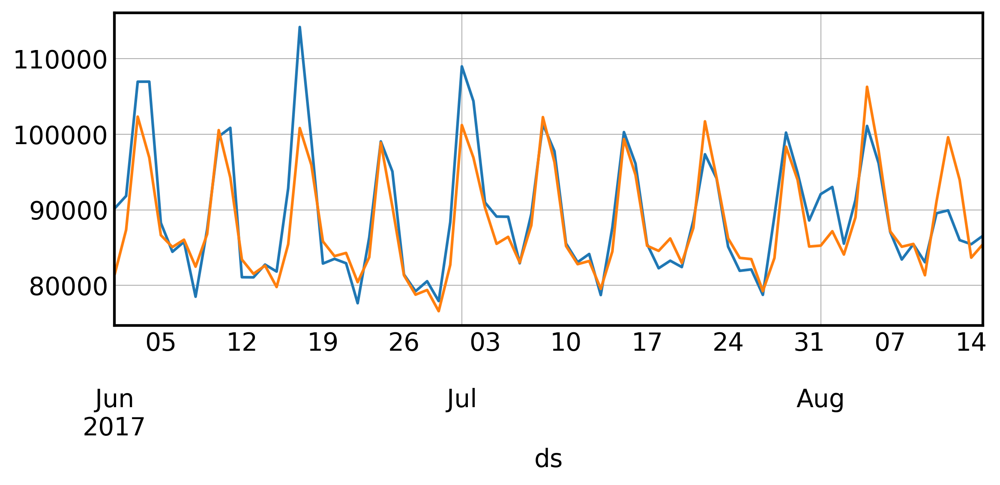

In [ ]:
df2y_test.plot()
df2y_pred.plot();

Профет - очень мощный фрэймворк для прогнозирования вр - различные нецелые сезонности, мультипликативные компоненты, кусочно-линейный тренд, который дает неплохие прогнозы прямо их коробки. Пожалуй, единственная слабость - шумные ряды, где экстраполяция начинает плохо работать

In [ ]:
from sktime.forecasting.tbats import TBATS

forecaster = TBATS(  

    use_box_cox=False,

    use_trend=False,

    use_damped_trend=False,

    sp=[7.,365.25],
    use_arma_errors=False,)

In [ ]:
df3 = evaluate(forecaster=forecaster, 
              y=transactions_series, 
              cv=tss, 
              strategy="refit", 
              return_data=True,
               error_score='raise')

In [ ]:
df3.head()

,test_MeanAbsolutePercentageError,fit_time,pred_time,len_train_window,cutoff,y_train,y_test,y_pred
0,0.041273,107.766231,0.012156,1581,2017-04-30,ds 2013-01-01 770 2013-01-02 93215 2...,ds 2017-06-01 90171 2017-06-02 91840 2...,ds 2017-06-01 79046.823171 2017-06-02 ...
1,0.034880,58.829014,0.012943,1612,2017-05-31,ds 2013-01-01 770 2013-01-02 93215 201...,ds 2017-07-01 108993 2017-07-02 104392 2...,ds 2017-07-01 100386.708435 2017-07-02 ...
2,0.062928,155.029990,0.012722,1642,2017-06-30,ds 2013-01-01 770 2013-01-02 93215 201...,ds 2017-08-01 92083 2017-08-02 93023 2...,ds 2017-08-01 80988.134652 2017-08-02 83...


In [ ]:
df3y_test = pd.concat([x for x in df3.y_test.values],ignore_index=True)
df3y_pred = pd.concat([x for x in df3.y_pred.values],ignore_index=True)

по метрикам из коробки получается не хуже, чем профет

In [ ]:
metrics_report(df3y_test.values,df3y_pred.values)

,mean,median,quan_75,quan_95,std
maes,3945.528159,3028.979266,5561.404268,10461.158469,3250.548455
maes_zero,6483.183518,6155.434211,9012.717105,15711.815789,4862.420169
mapes,4.293937,3.477167,6.399675,10.904302,3.276384
mapes_zero,7.137938,7.092850,10.172814,15.410483,4.850022
r2,0.602314,0.602314,0.602314,0.602314,0.602314


In [ ]:
metrics_report(df1y_test,df1y_pred)

,mean,median,quan_75,quan_95,std
maes,4027.586701,2925.318976,5993.009163,10742.878854,3652.844569
maes_zero,6483.183518,6155.434211,9012.717105,15711.815789,4862.420169
mapes,4.354149,3.293633,6.634540,11.432292,3.685203
mapes_zero,7.137938,7.092850,10.172814,15.410483,4.850022
r2,0.550375,0.550375,0.550375,0.550375,0.550375


# О подборе гиперпараметров

В этом разделе кратко обсудим некоторые общие практики для подбора гиперпараметров для различных моделей

## Пример плохого  подбора гиперпараметров

Для начала - как делать не надо. Плохая идея - подбирать гиперпараметры на той же выборке, на которой потом оцениваем качество. В этом случае происходит так называемая "утечка" данных, то есть мы используем данные, которые в будущем нам будут недоступны.

В качестве примера рассмотрим ряд с активностью солнечных пятен, и попробуем оценить по кросс-валидации на последних 100 точках 2 модели - для одной мы подберем гиперпараметры на всем вр, а для другой - не включая последние 100 точек

In [ ]:
Sun = pd.read_csv('data/sun.csv')
Sun['YEAR'] = pd.to_datetime(Sun['YEAR'].astype(int).astype(str) + '-01-01')
Sun.set_index("YEAR",inplace=True)
Sun.index = pd.PeriodIndex(Sun.index,freq='Y')

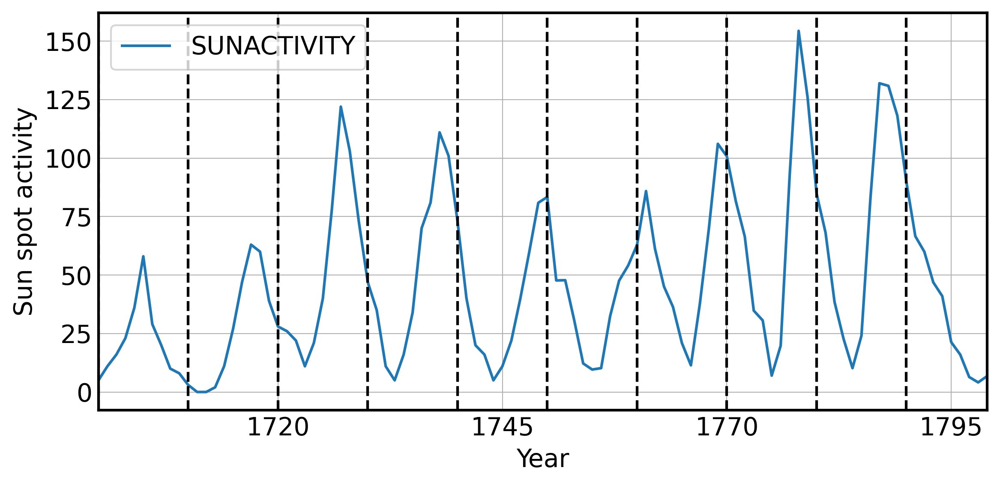

In [ ]:
ax = Sun[Sun.index<"1800-01-01"].plot()
ax.set_ylabel('Sun spot activity')
ax.set_xlabel('Year')
for i in range(0,100,10):
    ax.axvline(Sun.index[i],c='black',linestyle='--')

Подберем модель на всем вр

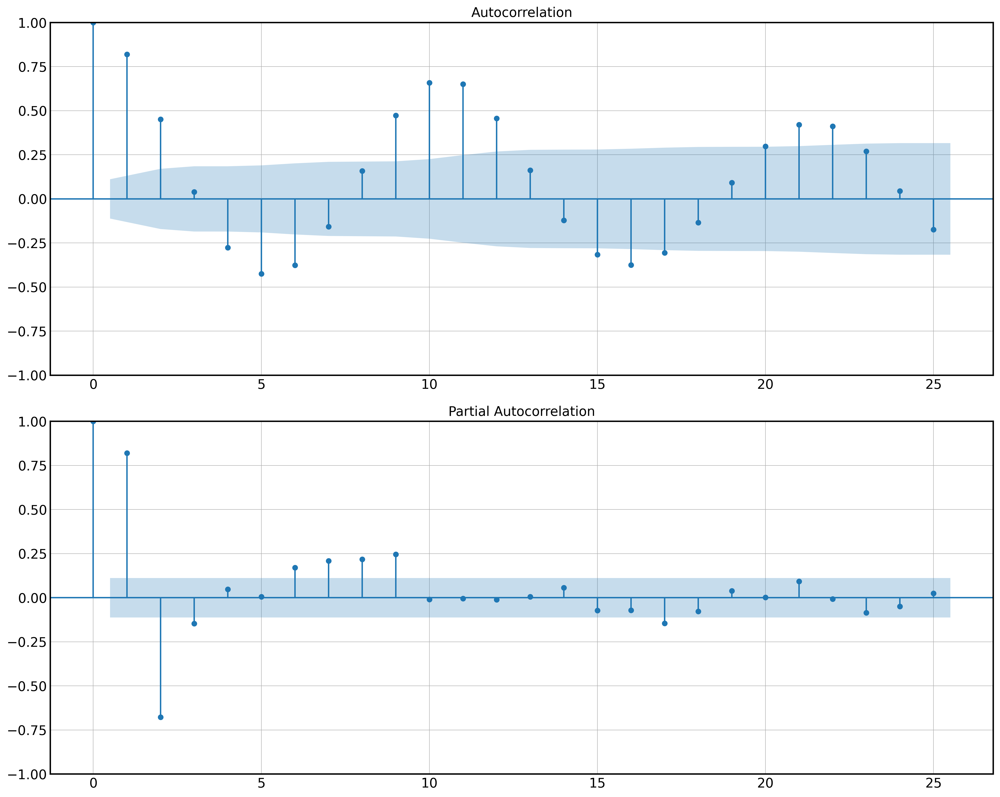

In [ ]:
fig,ax =plt.subplots(2,1,figsize= (15,12)) 
tsaplots.plot_acf(Sun,ax=ax[0]);
tsaplots.plot_pacf(Sun,ax=ax[1]);

In [ ]:
forecaster_all = calc_optimum_sarima(Sun,3,0,6,0,0,0,0)[1]

28


100%|██████████| 28/28 [00:55<00:00,  1.97s/it]


In [ ]:
forecaster_all.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:            SUNACTIVITY   No. Observations:                  309
Model:               SARIMAX(3, 0, 2)   Log Likelihood               -1287.795
Date:                Thu, 07 Aug 2025   AIC                           2587.589
Time:                        20:37:46   BIC                           2609.989
Sample:                    12-31-1700   HQIC                          2596.545
                         - 12-31-2008                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          2.6033      0.026     98.666      0.000       2.552       2.655
ar.L2         -2.5377      0.047    -53.470      0.000      -2.631      -2.445
ar.L3          0.9320      0.023     41.121      0.000       0.888       0.976
ma.L1         -1.5198      0.055    -27.568      0.000      -1.628      -1.412
ma.L2          0.6480      0.059     10.909      0.000       0.532       0.764
sigma2       239.8689     16.345     14.675      0.000     207.833     271.905
===================================================================================
Ljung-Box (L1) (Q):                   2.34   Jarque-Bera (JB):                62.20
Prob(Q):                              0.13   Prob(JB):                         0.00
Heteroskedasticity (H):               1.26   Skew:                             0.67
Prob(H) (two-sided):                  0.24   Kurtosis:                         4.75
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

Теперь подберем параметры модели на части вр без валидационной выборки.

In [ ]:
initial_window=200

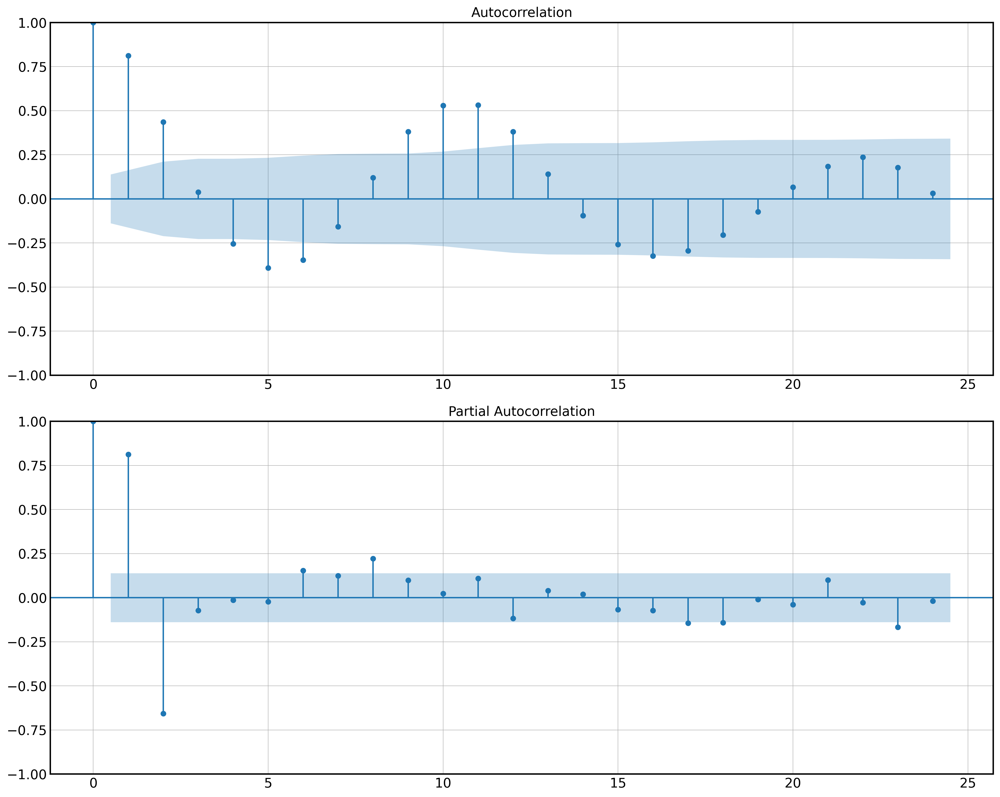

In [ ]:
fig,ax =plt.subplots(2,1,figsize= (15,12)) 
tsaplots.plot_acf(Sun.iloc[:initial_window],ax=ax[0]);
tsaplots.plot_pacf(Sun.iloc[:initial_window],ax=ax[1]);

In [ ]:
tbl, forecaster = calc_optimum_sarima(Sun.iloc[:initial_window],2,0,6,0,0,0,0)

21


100%|██████████| 21/21 [00:46<00:00,  2.19s/it]


In [ ]:
forecaster.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:            SUNACTIVITY   No. Observations:                  200
Model:               SARIMAX(1, 0, 2)   Log Likelihood                -845.202
Date:                Thu, 07 Aug 2025   AIC                           1698.403
Time:                        20:38:36   BIC                           1711.597
Sample:                    12-31-1700   HQIC                          1703.743
                         - 12-31-1899                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8227      0.043     18.952      0.000       0.738       0.908
ma.L1          0.7249      0.078      9.266      0.000       0.572       0.878
ma.L2          0.3265      0.084      3.902      0.000       0.163       0.491
sigma2       270.3229     20.555     13.151      0.000     230.035     310.611
===================================================================================
Ljung-Box (L1) (Q):                   0.20   Jarque-Bera (JB):                25.47
Prob(Q):                              0.66   Prob(JB):                         0.00
Heteroskedasticity (H):               1.43   Skew:                             0.32
Prob(H) (two-sided):                  0.15   Kurtosis:                         4.63
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

теперь их качество на кросс-валидации на последних 100 точках с шагом 1

In [ ]:
splitter1 = ExpandingWindowSplitter(fh=1,initial_window=initial_window,step_length=1)

In [ ]:
forecaster_all = ARIMA((3,0,3)) # подобрали по всей выборке
forecaster = ARIMA((1,0,2)) # подобрали по части выборки, выкинув валидацию

In [ ]:
df1progn = evaluate(forecaster=forecaster, 
              y=Sun.values, 
              cv=splitter1, 
              strategy="refit", 
              return_data=True)

df1progn_all = evaluate(forecaster=forecaster_all, 
              y=Sun.values, 
              cv=splitter1, 
              strategy="refit", 
              return_data=True)

In [ ]:
df1progn['y_pred'] = df1progn['y_pred'].apply(lambda x: x.values[0][0]) 
df1progn['y_test'] = df1progn['y_test'].apply(lambda x: x.values[0][0]) 

df1progn_all['y_pred'] = df1progn_all['y_pred'].apply(lambda x: x.values[0][0]) 
df1progn_all['y_test'] = df1progn_all['y_test'].apply(lambda x: x.values[0][0]) 

df1progn['resid'] = df1progn['y_test'] - df1progn['y_pred']
df1progn_all['resid'] = df1progn_all['y_test'] - df1progn_all['y_pred']

оценка качества модели

In [ ]:
metrics_report(df1progn['y_test'].values, df1progn['y_pred'].values)

,mean,median,quan_75,quan_95,std
maes,16.269221,12.840167,22.107643,40.485831,13.672744
maes_zero,39.433263,38.878899,51.478899,93.321101,26.541564
mapes,57.228065,35.938897,57.978204,153.674877,104.547157
mapes_zero,247.139867,58.102366,235.636308,1042.553098,536.661867
r2,0.800301,0.800301,0.800301,0.800301,0.800301


In [ ]:
metrics_report(df1progn_all['y_test'].values, df1progn_all['y_pred'].values)

,mean,median,quan_75,quan_95,std
maes,13.250127,10.184717,18.147260,34.676621,11.708911
maes_zero,39.433263,38.878899,51.478899,93.321101,26.541564
mapes,54.644323,23.791374,42.070736,184.064463,121.671775
mapes_zero,247.139867,58.102366,235.636308,1042.553098,536.661867
r2,0.861780,0.861780,0.861780,0.861780,0.861780


<Axes: >

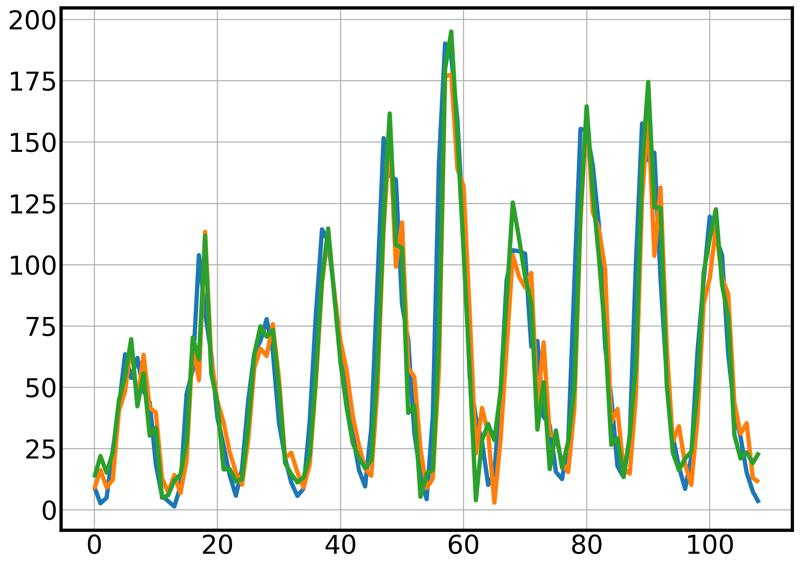

In [ ]:
df1progn['y_test'].plot()
df1progn['y_pred'].plot()
df1progn_all['y_pred'].plot();

Видно, что с параметрами, подобранными по всей выборке, качество модели лучше - т.е. они завышены по сравнению с реальной картиной. При подборе гиперпараметров нужно всегда держать в уме возможные "утечки данных", чтобы более точно оценивать качество прогнозов

## Примеры более правильного подбора гиперпараметров

В этом разделе посмотрим 2 стратегии подбора гиперпараметров - по статистическим критериям (согласно оценкам максимального правдоподобия на обучающей выборке) и по временной кросс-валидации

Для простоты будем подбирать параметры для ЭСС модели на вр международных авиаперелетов. Будем подбирать следующие параметры: сезонность - аддитивная/мультипликативная, тренд - аддитивный/мультипликативный, наличие затухания тренда - да/нет, период сезонности. Также теперь мы заранее создадим отложенную выборку с 24 наблюдениями и будем подбирать параметры, не смотря в валидационную часть

In [ ]:
airline = pd.read_csv('data/international-airline-passengers.csv', sep=';')
airline['Month'] = pd.to_datetime(airline['Month']+'-01')
airline.set_index('Month', inplace=True)
airline.index = pd.PeriodIndex(airline.index,freq='M')

In [ ]:
# отложим последние 24 наблюдения в тест чтобы сделать разовый прогноз на все 24 наблюдения
airline_test = airline.iloc[-24:]
airline = airline.iloc[:-24]

Начнем с временной кросс-валидации. Зададим её в том же виде, как на валидации - по последним 24 месяцам в обучающей выборке будем прогнозировать на 24 месяца вперед с шагом 1

In [ ]:
# отсупаем на 4 года от конца обучения, чтобы в итоге получить 24 предсказания с горизонтом прогнозирования 24
cv = ExpandingWindowSplitter(fh=list(range(1,25)), initial_window=len(airline['Passengers'])-48, step_length=1)

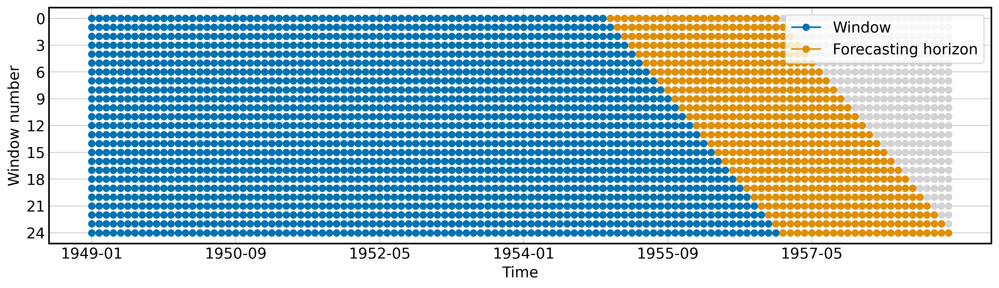

In [ ]:
# построим график нашей валидационной схемы - прогноз на 24 месяца скользящим окном в 1 месяц на последние 2 года
from sktime.utils.plotting import plot_windows

plot_windows(cv,airline);

In [ ]:
# подбираем параметры на кросс-валидационной схеме с помощью ForecastingGridSearchCV
from sktime.forecasting.exp_smoothing import ExponentialSmoothing
from sktime.forecasting.model_selection import ForecastingGridSearchCV
from sktime.performance_metrics.forecasting import MeanSquaredError

forecaster = ExponentialSmoothing()
param_grid = {
    "sp": [4, 6, 12],
    "seasonal": ["add", "mul"],
    "trend": ["add", "mul"],
    "damped_trend": [True, False],
}
gscv = ForecastingGridSearchCV(
    forecaster=forecaster, #модель
    param_grid=param_grid, # параметры для подбора
    cv=cv, # валидационная схема
    verbose=1,
)# по умолчанию подбирает по mape, за это отвечает параметр scoring
gscv.fit(airline)

Fitting 25 folds for each of 24 candidates, totalling 600 fits


ForecastingGridSearchCV(cv=ExpandingWindowSplitter(fh=[1, 2, 3, 4, 5, 6, 7, 8,
                                                       9, 10, 11, 12, 13, 14,
                                                       15, 16, 17, 18, 19, 20,
                                                       21, 22, 23, 24],
                                                   initial_window=72),
                        forecaster=ExponentialSmoothing(),
                        param_grid={'damped_trend': [True, False],
                                    'seasonal': ['add', 'mul'],
                                    'sp': [4, 6, 12], 'trend': ['add', 'mul']},
                        verbose=1)

In [ ]:
# оптимальные параметры
gscv.best_params_

{'damped_trend': True, 'seasonal': 'mul', 'sp': 12, 'trend': 'mul'}

In [ ]:
# датафрэйм с результатами валидации
gscv.cv_results_.head()

,mean_test_MeanAbsolutePercentageError,mean_fit_time,mean_pred_time,params,rank_test_MeanAbsolutePercentageError
0,0.160214,0.559224,0.035059,"{'damped_trend': True, 'seasonal': 'add', 'sp'...",14.0
1,0.182609,0.715527,0.025951,"{'damped_trend': True, 'seasonal': 'add', 'sp'...",21.0
2,0.154089,0.568971,0.027259,"{'damped_trend': True, 'seasonal': 'add', 'sp'...",11.0
3,0.181810,0.865809,0.027638,"{'damped_trend': True, 'seasonal': 'add', 'sp'...",20.0
4,0.083874,0.742543,0.019034,"{'damped_trend': True, 'seasonal': 'add', 'sp'...",7.0


In [ ]:
# переведем колонку с dict в отдельные колонки
gscv.cv_results_ = gscv.cv_results_.join(pd.DataFrame(gscv.cv_results_.pop('params').values.tolist()))

In [ ]:
# топ-моделей по мапе
gscv.cv_results_.sort_values(by='rank_test_MeanAbsolutePercentageError').head()

,mean_test_MeanAbsolutePercentageError,mean_fit_time,mean_pred_time,rank_test_MeanAbsolutePercentageError,damped_trend,seasonal,sp,trend
11,0.047960,0.661341,0.025887,1.0,True,mul,12,mul
23,0.048005,0.490619,0.018381,2.0,False,mul,12,mul
22,0.054310,0.435842,0.021172,3.0,False,mul,12,add
10,0.068794,0.639853,0.031641,4.0,True,mul,12,add
16,0.072864,0.546697,0.027400,5.0,False,add,12,add


Теперь попробуем другой метод валидации - по статистическим критериям, основанным на оценке максимального правдоподобия на обучающей выборке. Для этого обучим все вариации модели ExponentialSmoothing из statsmodels и выберем модель, которая обеспечивает наименьший скорректированный критерий Акаике, который рассчитывается в том же модуле.

In [ ]:
# скрипт отрабатывает примерно в 3-4 раза быстрее временной кросс-валидации
from statsmodels.tsa.api import ExponentialSmoothing

min_aicc = 1e100
top_es = None
for trend, is_damped, seasonal, sp in product(["add", "mul"],[True,False],["add", "mul"],[12,6,4]):
    es1 = ExponentialSmoothing(airline,
                               trend = trend,
                               seasonal = seasonal,
                               seasonal_periods = sp,
                               damped_trend = is_damped,
                               initialization_method='heuristic')
    es1 = es1.fit() # обучаем модель 
    if es1.aicc < min_aicc: # запоминаем модель с минимальным критерием акаике
        min_aicc = es1.aicc
        top_es = es1

In [ ]:
# оптимальная модель - такая же, как для временной кросс-валидации, но без затухающего тренда
top_es.summary()

Dep. Variable:,Passengers,No. Observations:,120
Model:,ExponentialSmoothing,SSE,11189.266
Optimized:,True,AIC,576.226
Trend:,Multiplicative,BIC,620.826
Seasonal:,Multiplicative,AICC,582.998
Seasonal Periods:,12,Date:,"Thu, 07 Aug 2025"
Box-Cox:,False,Time:,20:57:17
Box-Cox Coeff.:,None,,
,coeff,code,optimized
smoothing_level,0.3268786,alpha,True
smoothing_trend,0.000000,beta,True


In [ ]:
min_aicc

582.9984878989559

теперь оценим качество двух моделей на отложенной выборке

In [ ]:
# модель с параметрами на кросс-валидации
es_cv = ExponentialSmoothing(airline,
                               trend = "mul",
                               seasonal = 'mul',
                               seasonal_periods = 12,
                               damped_trend = True,) 

# модель с параметрами по критерию Акаике на обучающей выборке
es_mp = ExponentialSmoothing(airline,
                               trend = "mul",
                               seasonal = 'mul',
                               seasonal_periods = 12,
                               damped_trend = False,)

Обучим модели на всей обучающей выборке и оценим качество на валидационной

In [ ]:
es_cv = es_cv.fit()
y_pred_cv = es_cv.predict(len(airline),len(airline)+23)

es_mp = es_mp.fit()
y_pred_mp = es_mp.predict(len(airline),len(airline)+23)

In [ ]:
metrics_report(airline_test.values,y_pred_cv.values)

,mean,median,quan_75,quan_95,std
maes,11.136713,11.877461,15.785313,22.815050,6.679654
maes_zero,61.020833,51.500000,90.750000,147.225000,43.974048
mapes,2.523584,2.694548,3.154478,5.055588,1.534715
mapes_zero,13.404779,11.529146,17.878621,27.041097,8.790896
r2,0.970092,0.970092,0.970092,0.970092,0.970092


In [ ]:
metrics_report(airline_test.values,y_pred_mp.values)

,mean,median,quan_75,quan_95,std
maes,12.377664,12.239441,16.514223,22.405849,6.405901
maes_zero,61.020833,51.500000,90.750000,147.225000,43.974048
mapes,2.812462,2.912217,3.570833,5.404522,1.540437
mapes_zero,13.404779,11.529146,17.878621,27.041097,8.790896
r2,0.965476,0.965476,0.965476,0.965476,0.965476


Видим, что метрики близки друг к другу. Однако, на практике, часто бывает так, что при разбиении на train/test/holdout выборки, в обучающей выборке остается мало данных, в следствие чего падает качество подобранных гиперпараметров. Подбор гиперпараметров по стат критериям такой проблемы не имеет. При достаточным кол-ве данных часто оказывается, что оба метода дают примерно одинаковое улучшения метрик модели, при этом подбор по стат критерия всегда в несколько раз быстрее за счет того, что обучается только один раз. Поэтому если в модуле, которым вы пользуетесь для прогноза, есть оценки максимального правдоподобия, то для подбора гиперпараметров в рамках одной модели рекомендуется использовать именно метод стат. критериев.

## Примеры подбора оптимальной модели

Совсем другая ситуация, когда мы обучили несколько моделей и хотим выбрать наилучшую, или, мы хотим понять, нужны ли нам какие-то предварительные трансформации (например, детрендирование или применение преобразования бокса-кокса). В этом случае мы не всегда можем оценить мпп, а даже если и можем, для разных питон-пакетов и разных моделей оно может считать по-разному, поэтому сравнивать их между собой не совсем корректно. Поэтому здесь рекомендуется использовать кросс-валидацию для определения оптимальной модели

In [ ]:
from sktime.forecasting.exp_smoothing import ExponentialSmoothing
from sktime.forecasting.fbprophet import Prophet as prophet_sktime
from sktime.forecasting.naive import NaiveForecaster
from sktime.forecasting.statsforecast import (
    StatsForecastAutoARIMA,
    StatsForecastAutoETS,
    StatsForecastMSTL,
)
from sktime.forecasting.structural import UnobservedComponents
from sktime.forecasting.theta import ThetaForecaster
from sktime.forecasting.trend import STLForecaster

In [ ]:
# убираем ненужные принты
import warnings

warnings.simplefilter("ignore")
warnings.simplefilter("ignore", DeprecationWarning)
warnings.simplefilter("ignore", FutureWarning)

import logging

logging.getLogger('prophet').setLevel(logging.ERROR)

давайте подберем оптимальную модель для датасета с кол-вом международных авиаперелетов

In [ ]:
# для кросс-валидации по времени с помощью sktime даты должны содержать в индексе, который должен быть pd.PeriodIndex
airline_val = airline['Passengers']
airline_val.index = pd.PeriodIndex(airline_val.index,freq='M')

In [ ]:
from sktime.transformations.series.detrend import (
    Deseasonalizer,
    Detrender,
    STLTransformer,
)

In [ ]:
from sktime.forecasting.compose import (
    MultiplexForecaster,  # оберка для выбора оптимальной модели из списка
)
from sktime.forecasting.model_selection import ForecastingGridSearchCV
from sktime.split import ExpandingWindowSplitter

# проведем валидацию аналогично пункту 2.2
cv = ExpandingWindowSplitter(fh=24, initial_window=len(airline['Passengers'])-48, step_length=1)

forecaster = MultiplexForecaster(
    forecasters=[
        ("ets", ExponentialSmoothing(sp=12,seasonal ='mul',trend ='mul')), # наша оптимальная ets модель
        ("auto_ets", StatsForecastAutoETS(season_length=12)), # авто-эсс из пакета statsforecast
        ("auto_arima", StatsForecastAutoARIMA(sp=12)), # autoarima из пакета statsforecast
        ("stl", STLForecaster(sp=12)), # прогноз, основанный на stl-декомпозии (тренд - экстраполируют, сезонность - предыдущ.)
        ("auto_arima_stl", STLForecaster(sp=12, # здесь дополнительно остатки моделируются автоаримой
                                         forecaster_resid=AutoARIMA(suppress_warnings=True,sp=12))),  
        ("prophet", prophet_sktime(freq='M')), # дефолтный профет
    ]
)
gscv = ForecastingGridSearchCV(
    forecaster=forecaster,
    param_grid={"selected_forecaster": ["auto_arima_stl","stl","ets","auto_arima","prophet","auto_ets",]},
    cv=cv,
    n_jobs=6
)
gscv.fit(airline['Passengers'])
gscv.best_params_

In [ ]:
gscv.cv_results_ 

,mean_test_MeanAbsolutePercentageError,mean_fit_time,mean_pred_time,params,rank_test_MeanAbsolutePercentageError
0,0.070067,8.216553,0.061790,{'selected_forecaster': 'auto_arima_stl'},1.0
1,0.070458,0.020502,0.049521,{'selected_forecaster': 'stl'},2.0
2,0.078439,0.218288,0.007037,{'selected_forecaster': 'ets'},3.0
3,0.079300,2.193088,0.062692,{'selected_forecaster': 'auto_arima'},4.0
4,0.102140,0.521680,0.060022,{'selected_forecaster': 'prophet'},5.0
5,0.160463,1.296050,0.027633,{'selected_forecaster': 'auto_ets'},6.0


Лучший результат показала комбинация arima+stl. Видно, что при грамотном использовании arima может улучшать результат базовой декомпозиции. Ну и в целом - первые 3 места заняли модели, которые в первую очередь декомпозируют ряд на составляющие. Также можно отметить, что на этом датасете профет сильно проигрывает в качестве stl, ets и autoarima - потому что профет лучше работает именно на дневных данных, а не на месячных

Теперь подберем модель для датасета с солнечными пятнами

In [ ]:
from sktime.forecasting.compose import MultiplexForecaster
from sktime.forecasting.model_selection import ForecastingGridSearchCV
from sktime.split import ExpandingWindowSplitter

# валидация с шагом 1 на последние 50 точек
cv = ExpandingWindowSplitter(fh=1, initial_window=250, step_length=1)

# т.к. период непостоянен, поставим модели без периодической компоненты
# кроме stl
forecaster = MultiplexForecaster(
        forecasters=[
        ("ets", ExponentialSmoothing(sp=1,seasonal =None,trend ='add')), 
        ("auto_ets", StatsForecastAutoETS(season_length=1)),
        ("auto_arima", StatsForecastAutoARIMA(sp=1)),
        ("stl", STLForecaster(sp=10)),
        ("prophet", prophet_sktime()),
    ]
)
gscv = ForecastingGridSearchCV(
    forecaster=forecaster,
    param_grid={"selected_forecaster": ["stl","ets","auto_arima","prophet","auto_ets",]},
    cv=cv,
    n_jobs=6
)
gscv.fit(Sun)
gscv.best_params_

In [ ]:
gscv.cv_results_ 

,mean_test_MeanAbsolutePercentageError,mean_fit_time,mean_pred_time,params,rank_test_MeanAbsolutePercentageError
0,1.263899,0.023899,0.046038,{'selected_forecaster': 'stl'},5.0
1,0.556005,0.042571,0.008598,{'selected_forecaster': 'ets'},2.0
2,0.519086,1.122776,0.034586,{'selected_forecaster': 'auto_arima'},1.0
3,1.218840,0.102051,0.058486,{'selected_forecaster': 'prophet'},4.0
4,0.573699,0.462069,0.015056,{'selected_forecaster': 'auto_ets'},3.0


Здесь Arima справляется лучше всего - только в её модели заложены возможная стохастическая сезонность с переменным периодом. Для прогноза на 1 шаг неплохо справляется и ets, а вот профет и stl,  заточенные под сезонность, справляются сильно хуже.

итоговая модель arima

In [ ]:
gscv.best_forecaster_.forecaster_._forecaster.model_

{'coef': {'ar1': 1.614676506303526,
  'ar2': -0.9353737347406413,
  'ma1': -1.4392981370795868,
  'ma2': 0.45409831233872117,
  'ma3': 0.12868260018441569},
 'sigma2': 240.65999552378662,
 'var_coef': array([[ 0.00035137, -0.00012861, -0.00167719,  0.00219083, -0.00041525],
        [-0.00027742,  0.00012638,  0.00135796, -0.00186264,  0.0002926 ],
        [-0.00256147,  0.00105991,  0.01630343, -0.02053642,  0.00285351],
        [ 0.00342001, -0.00147332, -0.02053642,  0.02642046, -0.0037274 ],
        [-0.0005978 ,  0.00021881,  0.00285351, -0.0037274 ,  0.00070649]]),
 'mask': array([ True,  True,  True,  True,  True]),
 'loglik': -1280.0232952051606,
 'aic': 2572.046590410321,
 'arma': (2, 3, 0, 0, 1, 1, 0),
 'residuals': array([ 4.99999399e-03,  3.87028735e+00,  1.36132688e+00,  3.96440575e+00,
         8.89876623e+00,  1.59974149e+01, -3.03198360e+01,  7.98035937e+00,
        -1.07990033e+00,  4.36665489e+00, -5.29170397e+00, -6.16617969e+00,
        -6.84045002e+00, -7.14354119e+

In [ ]:
from statsforecast.arima import arima_string, print_statsforecast_ARIMA

In [ ]:
print_statsforecast_ARIMA(gscv.best_forecaster_.forecaster_._forecaster.model_)

ARIMA(2,1,3)                   

Coefficients:
               ar1    ar2    ma1    ma2    ma3
coefficient  1.615 -0.935 -1.439  0.454  0.129
s.e.         0.019  0.011  0.128  0.163  0.027

sigma^2 = 240.66: log likelihood = -1280.02

AIC=2572.05


Наконец, посмотрим как данные модели справляются с длинными подневными данными.

In [ ]:
transactions_series_val = transactions_series
transactions_series_val.index = pd.PeriodIndex(transactions_series_val.index,freq='D')

In [ ]:
from sktime.forecasting.compose import MultiplexForecaster
from sktime.forecasting.model_selection import ForecastingGridSearchCV
from sktime.split import ExpandingWindowSplitter

# в качестве валидации берем последний месяц
cv = ExpandingWindowSplitter(fh=31, initial_window=len(transactions_series)-62, step_length=1)

# для моделей с одной сезонностью будем брать с меньшей частотой, чтобы более долгая частота попала в тренд
forecaster = MultiplexForecaster(
        forecasters=[
        ("ets", ExponentialSmoothing(sp=7,seasonal ='add',trend ='add')),# ets c одной сезонностью
        ("auto_arima", StatsForecastAutoARIMA(sp=7)),
        ("stl", STLForecaster(sp=7)),
        ("mstl", StatsForecastMSTL(season_length=[7,365])),# STL с двумя сезонностями
        ("auto_arima_stl", STLForecaster(sp=7,
                                         forecaster_resid=AutoARIMA(suppress_warnings=True,sp=7))),#stl + autoarima
        ("prophet", prophet_sktime()),
    ]
)
gscv = ForecastingGridSearchCV(
    forecaster=forecaster,
    param_grid={"selected_forecaster": ["auto_arima_stl","stl","ets","auto_arima","prophet","mstl",]},
    cv=cv
)
gscv.fit(transactions_series_val)
gscv.best_params_

12:42:29 - cmdstanpy - INFO - Chain [1] start processing
12:42:29 - cmdstanpy - INFO - Chain [1] done processing
12:42:29 - cmdstanpy - INFO - Chain [1] start processing
12:42:29 - cmdstanpy - INFO - Chain [1] done processing


{'selected_forecaster': 'prophet'}

In [ ]:
gscv.cv_results_ 

,mean_test_MeanAbsolutePercentageError,mean_fit_time,mean_pred_time,params,rank_test_MeanAbsolutePercentageError
0,0.060481,82.196625,0.063544,{'selected_forecaster': 'auto_arima_stl'},5.0
1,0.059961,0.046648,0.046901,{'selected_forecaster': 'stl'},4.0
2,0.037300,0.358120,0.026635,{'selected_forecaster': 'ets'},2.0
3,0.109121,5.719432,0.062153,{'selected_forecaster': 'auto_arima'},6.0
4,0.033304,0.406444,0.069019,{'selected_forecaster': 'prophet'},1.0
5,0.041680,3.506733,0.017783,{'selected_forecaster': 'mstl'},3.0


На длинных данных с двумя сезонностями prophet первенствует, а auto-arima, наоборот, находится в конце рейтинга

In [ ]:
MultiplexForecaster(forecasters=[("stl", STLForecaster(sp=7)),
                                 ("auto_arima", StatsForecastAutoARIMA(sp=7))]).get_tag('ignores-exogeneous-X')

In [ ]:
MultiplexForecaster(forecasters=[("auto_arima", StatsForecastAutoARIMA(sp=7))]).get_tag('ignores-exogeneous-X')